In [1]:
import numpy as np
import scanpy as sc
import scvelo as scv
import sys
import torch
import matplotlib.pyplot as plt
import umap
import os
import os.path
sys.path.append('../')
import velovae as vv
from datetime import datetime
import seaborn as sns
import pandas as pd
import plotnine as p9

In [2]:
torch.cuda.is_available()

True

In [3]:
now = datetime.now()
date = now.strftime("%m_%d_%Y")

In [4]:
adata = sc.read_h5ad('../../RNA_ATAC/macrophage/8489-MV-1-9060-MV-3_adata_postpro_concat.h5ad')
adata_atac = sc.read_h5ad('../../RNA_ATAC/macrophage/8489-MV-1-9060-MV-3_adata_atac_postpro_concat.h5ad')

In [5]:
gene_plot = ['AZU1', 'HBD', 'HDC', 'LYZ', 'PF4', 'SPINK2', 'CTSS', 'SPP1']
np.isin(gene_plot, adata.var_names)

array([ True,  True,  True,  True,  True,  True,  True,  True])

In [6]:
'PROM1' in adata.var_names

True

In [7]:
dataset = "8489-MV-1-9060-MV-3"
model_path_base = f"checkpoints/{dataset}"
figure_path_base = f"figures/{dataset}"
data_path_base = f"data/{dataset}"

In [8]:
adata, adata_atac

(AnnData object with n_obs × n_vars = 9908 × 929
     obs: 'total_unspliced', 'total_spliced', 'log1p_total_unspliced', 'log1p_total_spliced', 'fraction_u', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'log1p_total_counts_rb', 'pct_counts_rb', 'total_counts_hla', 'log1p_total_counts_hla', 'pct_counts_hla', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'outlier', 'initial_size_unspliced', 'initial_size_spliced', 'initial_size', 'n_counts', 'S_score', 'G2M_score', 'phase', 'CC_difference', 'total_unspliced2', 'total_spliced2', 'log1p_total_unspliced2', 'log1p_total_spliced2', 'fraction_u2', 'n_c', 'n_Mu', 'n_Ms', 'leiden', 'total_chromatin', 'total_unspliced3', 'total_spliced3', 'log1p_total_unspliced3', 'log1p_total_spliced3', 'fraction_u3', 'total_Mc', 'total_Mu', 'total_Ms', 'batch', 'n_Mc'
     var: 'gene_ids', 'feature_

In [9]:
adata.obs['leiden'].cat.categories

Index(['CMP', 'DC', 'Erythrocyte', 'GMP', 'Granulocyte', 'HSC', 'LMPP',
       'M1 Macrophage', 'M2 Macrophage', 'MDP', 'MEP', 'Mast Cells',
       'Megakaryocyte', 'Monocyte', 'Platelet', 'Prog DC', 'Prog MK'],
      dtype='object')

In [10]:
adata.obs['batch'].cat.categories

Index(['Day 7', 'Day 14'], dtype='object')

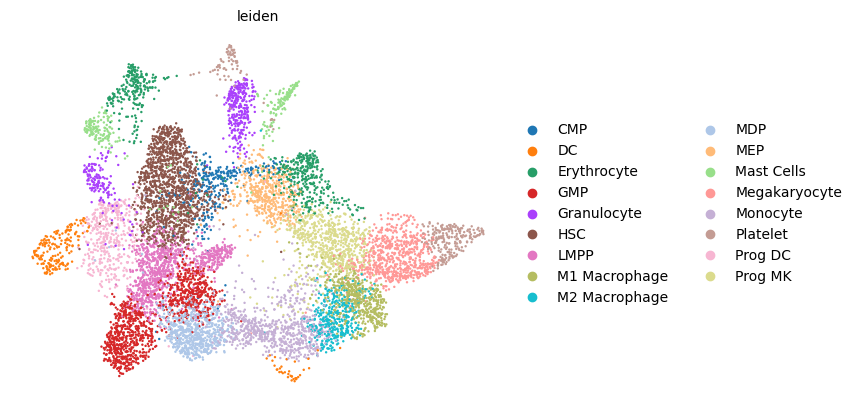

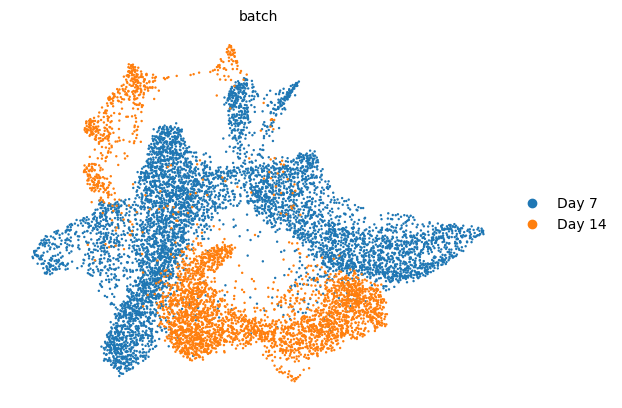

In [11]:
os.makedirs(figure_path_base, exist_ok=True)
scv.pl.scatter(adata, basis='umap', color='leiden', legend_loc='right margin')
scv.pl.scatter(adata, basis='umap', color='batch', legend_loc='right margin')

In [12]:
figure_path = figure_path_base+'/'+date
model_path = model_path_base+'/'+date
data_path = data_path_base

In [13]:
torch.manual_seed(2022)
np.random.seed(2022)
model = vv.VAEChrom(adata,
                    adata_atac,
                    batch_key='batch',
                    ref_batch=0,
                    batch_hvg_key='highly_variable',
                    var_to_regress=['total_unspliced3'],
                    device='cuda:0',
                    plot_init=False,
                    gene_plot=gene_plot,
                    cluster_key="leiden",
                    figure_path=figure_path,
                    embed="umap")

model.train(plot=False,
            gene_plot=gene_plot,
            figure_path=figure_path,
            embed="umap")

model.save_model(model_path)
model.save_anndata(data_path, file_name="out.h5ad")

CVAE enabled. Performing batch effect correction.
Reference batch set to 0 (Day 7).
Latent dimension set to 8.
KL weights set to 2.00 2.00.
Found ['total_unspliced3'] in obs. Regressing them out.
Batch 0 sparsity: 0.122
Batch 1 sparsity: 0.106
Learning rate set to 7.7e-4 based on data sparsity.
Early stop threshold set to 1.6.
Using Gaussian Prior.
Initializing using the steady-state and dynamical models.


  0%|          | 0/929 [00:00<?, ?it/s]

849 out of 929 = 91.4% genes have good ellipse fits.
KS-test result: [1. 1. 1. 1. 1. 1. 1.]
Assigning cluster 2 to repressive.
Initial induction: 714, repression: 215 out of 929.
Computing scaling factors for each batch class.
--------------------------- Train a VeloVAE ---------------------------
*********      Creating Training and Validation Datasets      *********
Total Number of Iterations Per Epoch: 28, test iteration: 54
*********                      Finished.                      *********
*********                      Stage  1                       *********
Epoch 1: Train ELBO = -2688.083, Test ELBO = -49984.745		Total Time =   0 h :  0 m :  0 s
Epoch 50: Train ELBO = 2096.158, Test ELBO = 2080.189		Total Time =   0 h :  0 m : 10 s
Epoch 100: Train ELBO = 2157.434, Test ELBO = 2143.381		Total Time =   0 h :  0 m : 20 s
Epoch 150: Train ELBO = 2176.633, Test ELBO = 2162.807		Total Time =   0 h :  0 m : 30 s
*********     Stage 1: Early Stop Triggered at epoch 199.     ******

  0%|          | 0/9908 [00:00<?, ?it/s]

Percentage of Invalid Sets: 0.002
Average Set Size: 44
Finished. Actual Time:   0 h :  0 m : 10 s
*********             Velocity Refinement Round 1             *********
Epoch 210: Train ELBO = 2116.457, Test ELBO = 2103.332		Total Time =   0 h :  0 m : 52 s
*********     Round 1: Early Stop Triggered at epoch 210.     *********
*********     Retrieving best model from iteration 5852.      *********
Cell-wise KNN estimation.
Finished. Actual Time:   0 h :  0 m :  1 s
*********             Velocity Refinement Round 2             *********
Epoch 216: Train ELBO = 2058.629, Test ELBO = 2046.996		Total Time =   0 h :  0 m : 55 s
*********     Round 2: Early Stop Triggered at epoch 216.     *********
*********     Retrieving best model from iteration 6014.      *********
Change in x0: 0.194
Cell-wise KNN estimation.
Finished. Actual Time:   0 h :  0 m :  1 s
*********             Velocity Refinement Round 3             *********
Epoch 220: Train ELBO = 1996.865, Test ELBO = 1984.590		Total 

In [14]:
key = "vae"
basis = "umap"

In [15]:
z = adata.obsm[f'{key}_z']
t = adata.obs[f'{key}_time'].to_numpy()
rho = adata.layers[f'{key}_rho']
kc = adata.layers[f'{key}_kc']

In [16]:
umap_obj = umap.UMAP(n_neighbors=30, n_components=2, min_dist=0.25, random_state=2022)
z_umap = umap_obj.fit_transform(z)

z_batch = adata.obsm[f'{key}_z_batch']
umap_obj = umap.UMAP(n_neighbors=30, n_components=2, min_dist=0.25, random_state=2022)
z_umap2 = umap_obj.fit_transform(z_batch)

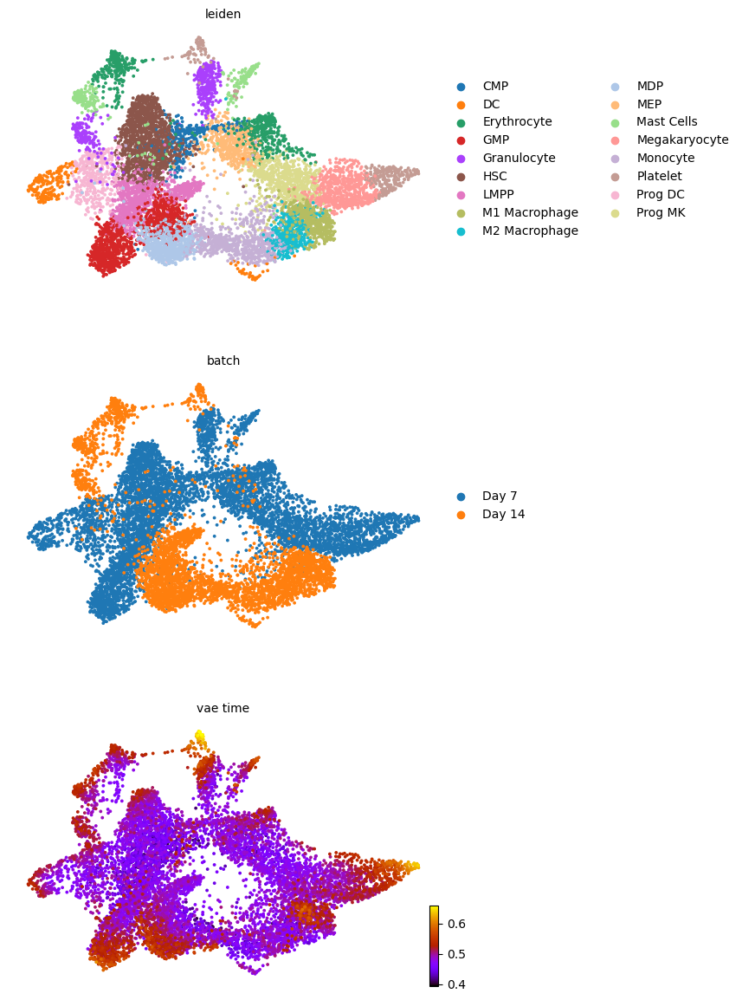

saving figure to file figures/8489-MV-1-9060-MV-3/11_11_2024/8489-MV-1-9060-MV-3_z_batch_time_vae.png


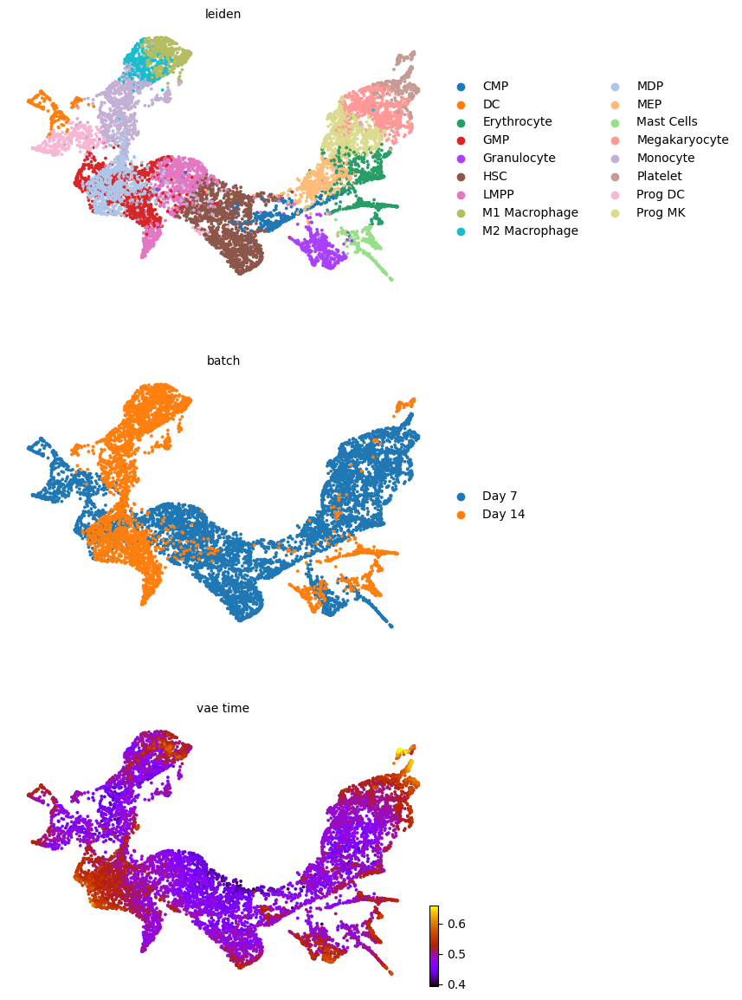

saving figure to file figures/8489-MV-1-9060-MV-3/11_11_2024/8489-MV-1-9060-MV-3_z_batch_time2_vae.png


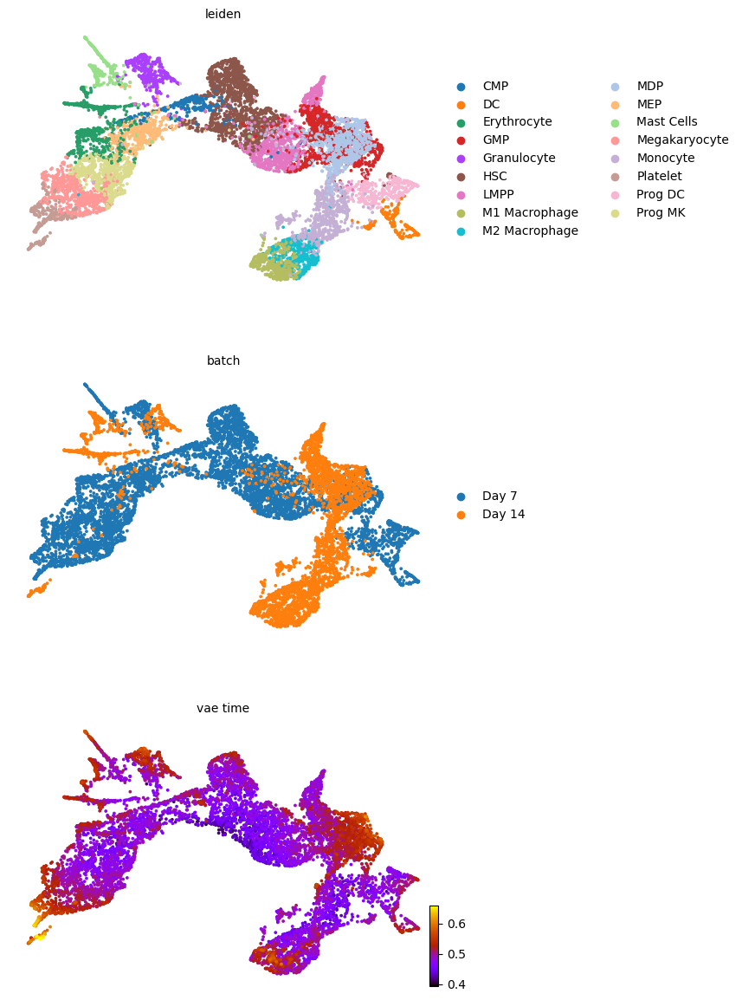

In [17]:
scv.pl.scatter(adata, basis='umap', color=['leiden', 'batch', f'{key}_time'], legend_loc='right', color_map='gnuplot', ncols=1, size=30)
adata.obsm['X_z_umap'] = z_umap
scv.pl.scatter(adata, basis='z_umap', color=['leiden', 'batch', f'{key}_time'], legend_loc='right', color_map='gnuplot', ncols=1, size=30, save=f'{figure_path}/{dataset}_z_batch_time_{key}.png')
adata.obsm['X_z_umap2'] = z_umap2
scv.pl.scatter(adata, basis='z_umap2', color=['leiden', 'batch', f'{key}_time'], legend_loc='right', color_map='gnuplot', ncols=1, size=30, save=f'{figure_path}/{dataset}_z_batch_time2_{key}.png')

In [18]:
adata.obsm[f'{key}_latent'] = np.concatenate((adata.obsm[f'{key}_z'], adata.obsm[f'{key}_t']), axis=1)
sc.pp.neighbors(adata, use_rep=f'{key}_latent', n_neighbors=50)

computing velocity graph (using 1/8 cores)


  0%|          | 0/9908 [00:00<?, ?cells/s]

    finished (0:00:17) --> added 
    'vae_velocity_norm_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'vae_velocity_norm_z_umap', embedded velocity vectors (adata.obsm)


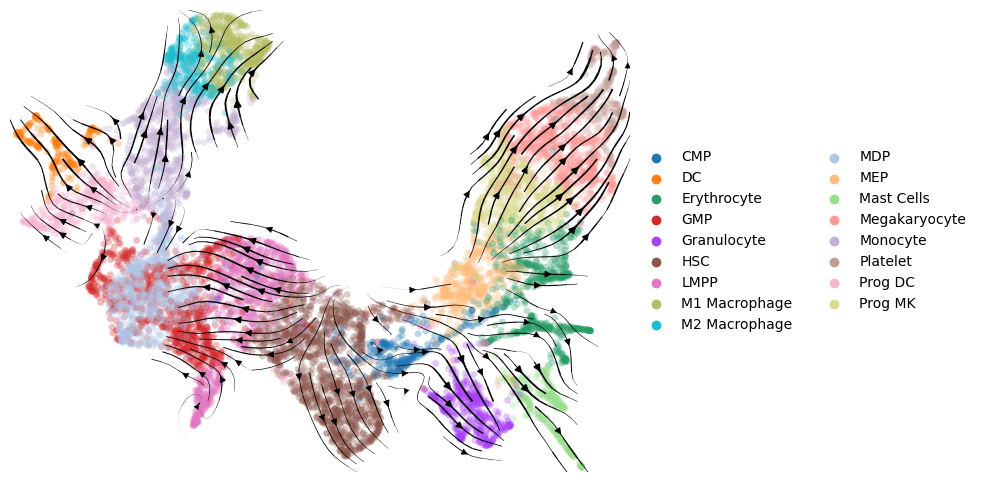

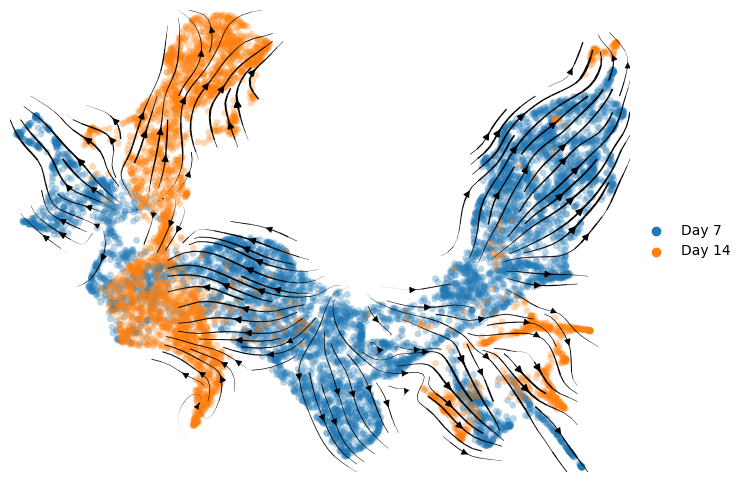

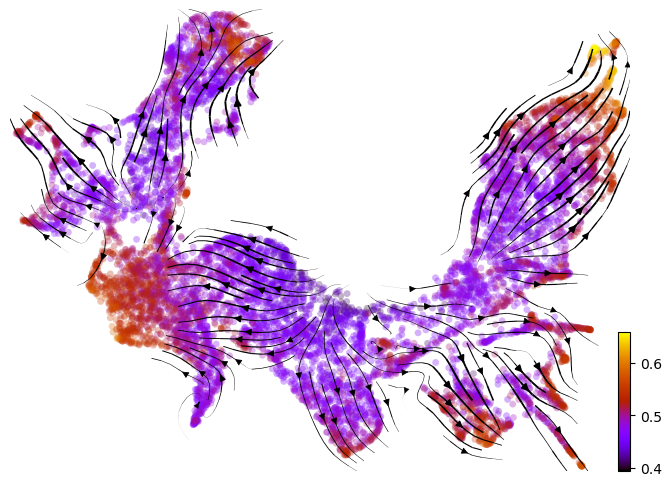

In [19]:
adata.obsm['X_z_umap'] = z_umap
vv.model.velocity_graph(adata, key=key, batch_corrected=True)
vv.velocity_embedding_stream(adata, key=key, basis='z_umap', color='leiden', title="", figsize=(8,6), legend_loc='right margin')
vv.velocity_embedding_stream(adata, key=key, basis='z_umap', color='batch', title="", figsize=(8,6), legend_loc='right margin')
vv.velocity_embedding_stream(adata, key=key, basis='z_umap', color=f'{key}_time', color_map='gnuplot', title="", figsize=(8,6), legend_loc='right margin')

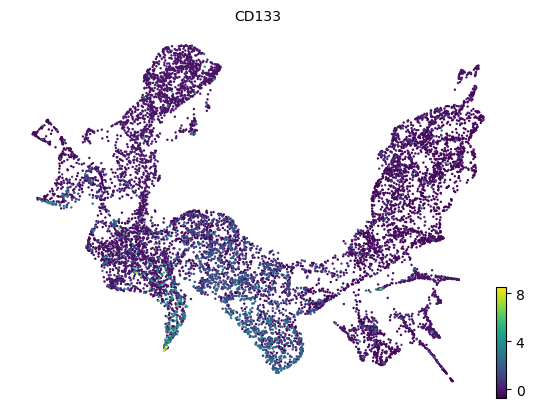

In [20]:
scv.pl.scatter(adata, color='PROM1', basis='z_umap', title='CD133')

In [21]:
top_genes = adata[:, adata.var[f'{key}_velocity_genes']].var[f'{key}_likelihood'].sort_values(ascending=False).index

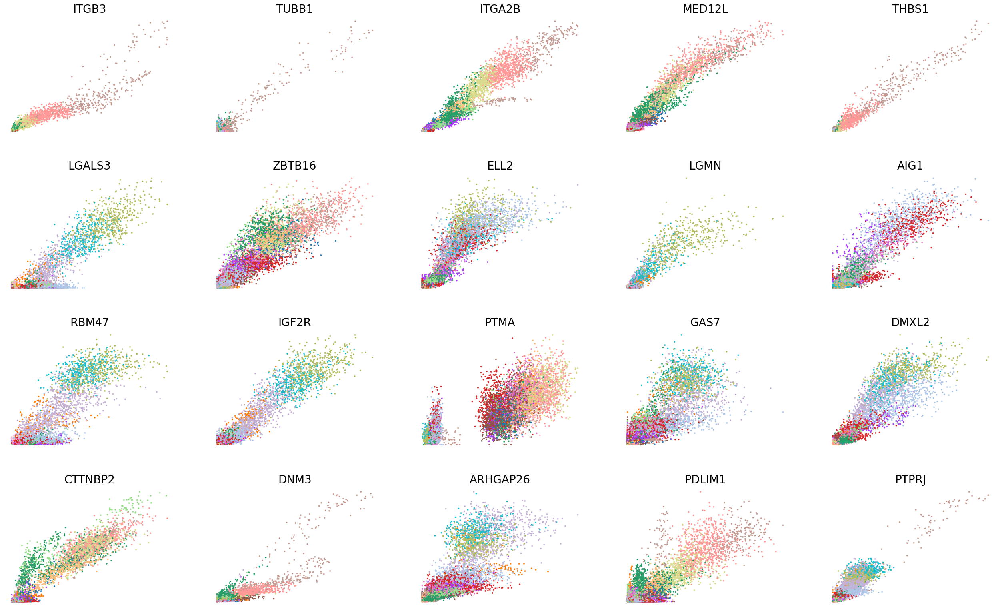

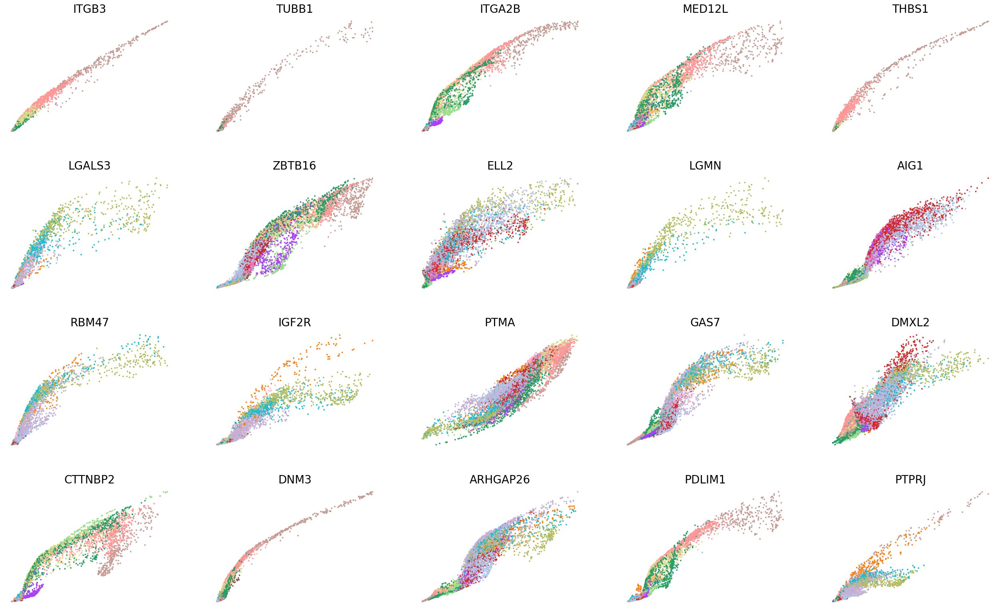

In [22]:
scv.pl.scatter(adata, basis=top_genes[:20], color='leiden', ncols=5, frameon=False, fontsize=20, size=30)
scv.pl.scatter(adata, basis=top_genes[:20], x=f'{key}_shat', y=f'{key}_uhat', color='leiden', ncols=5, frameon=False, fontsize=20, size=30)

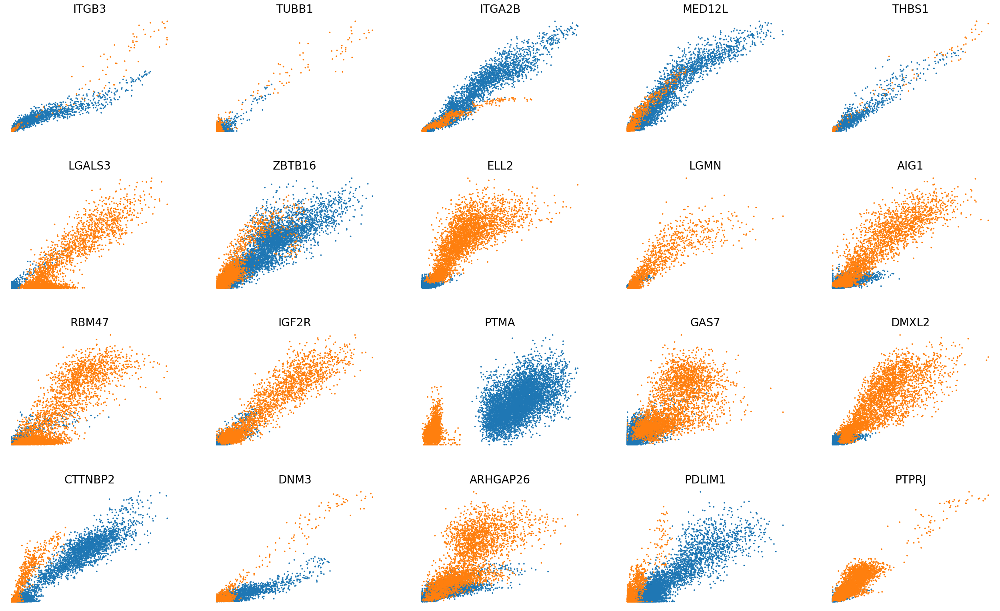

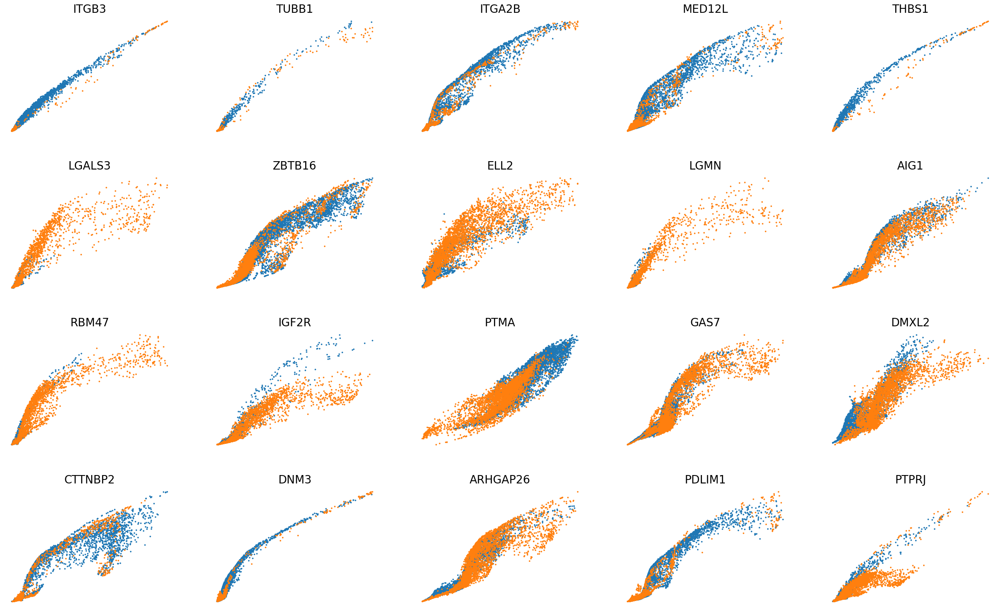

In [23]:
scv.pl.scatter(adata, basis=top_genes[:20], color='batch', ncols=5, frameon=False, fontsize=20, size=30)
scv.pl.scatter(adata, basis=top_genes[:20], x=f'{key}_shat', y=f'{key}_uhat', color='batch', ncols=5, frameon=False, fontsize=20, size=30)

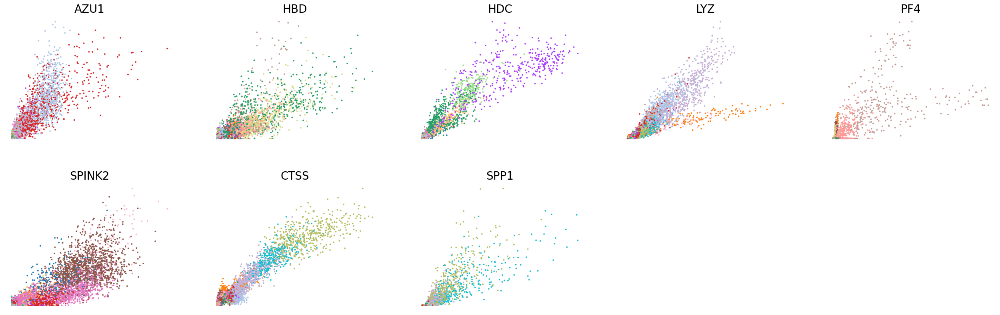

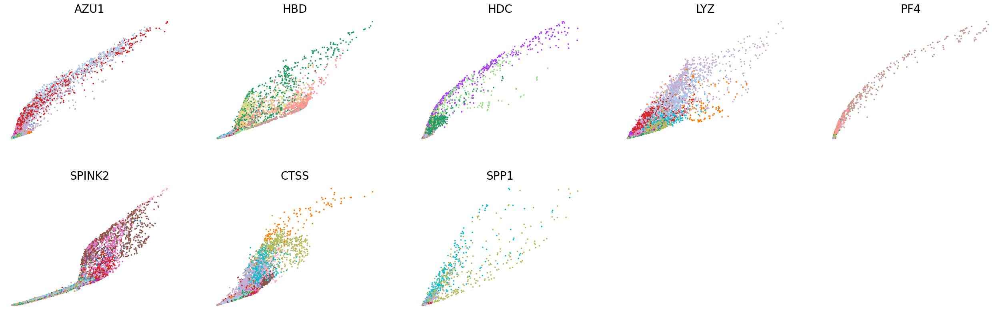

In [24]:
scv.pl.scatter(adata, basis=gene_plot, color='leiden', ncols=5, frameon=False, fontsize=20, size=30)
scv.pl.scatter(adata, basis=gene_plot, x=f'{key}_shat', y=f'{key}_uhat', color='leiden', ncols=5, frameon=False, fontsize=20, size=30)

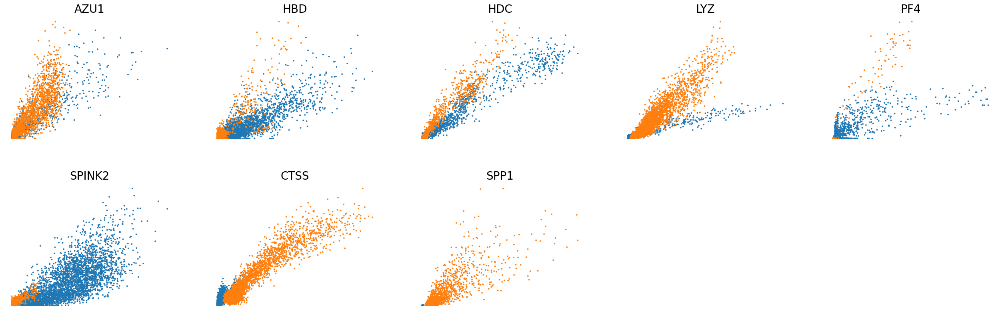

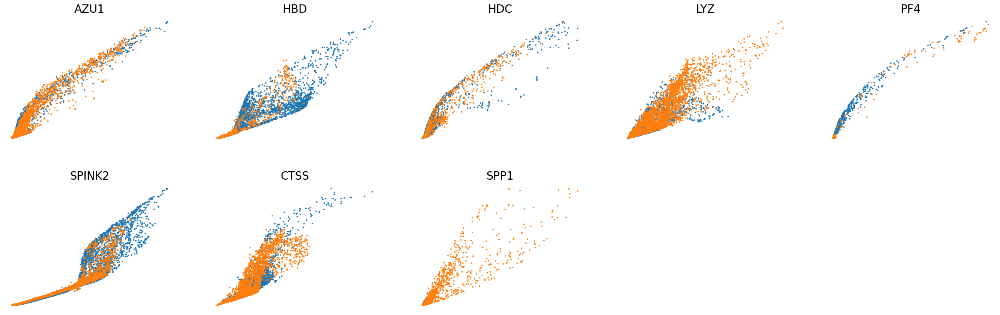

In [25]:
scv.pl.scatter(adata, basis=gene_plot, color='batch', ncols=5, frameon=False, fontsize=20, size=30)
scv.pl.scatter(adata, basis=gene_plot, x=f'{key}_shat', y=f'{key}_uhat', color='batch', ncols=5, frameon=False, fontsize=20, size=30)

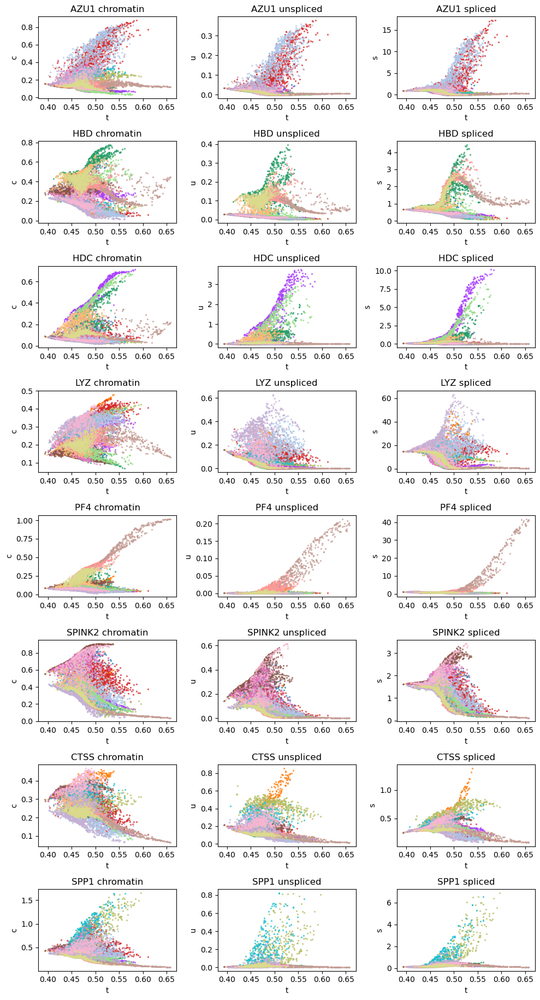

In [26]:
vv.dynamic_plot(adata, adata_atac, gene_plot, color_by='leiden', batch_correction=True)

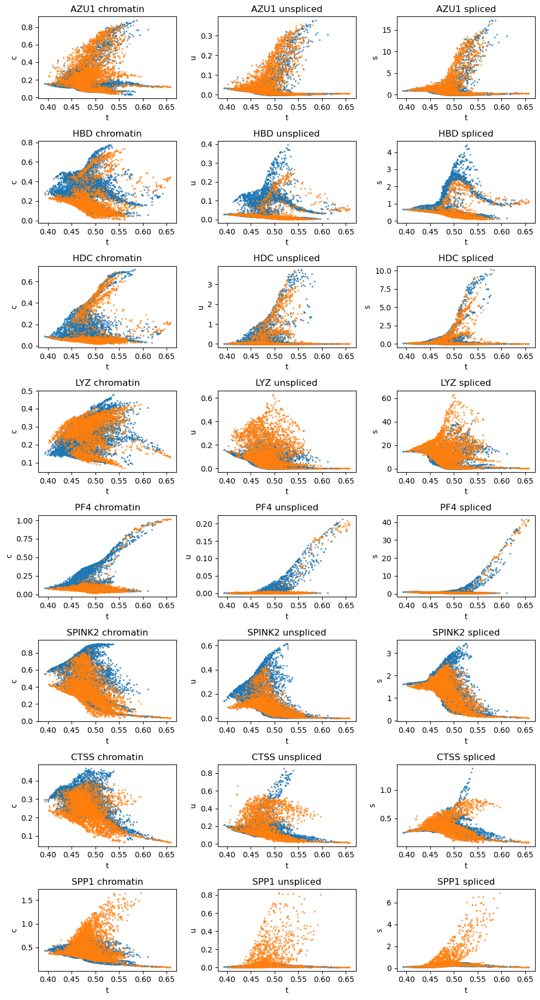

In [27]:
vv.dynamic_plot(adata, adata_atac, gene_plot, color_by='batch', batch_correction=True)

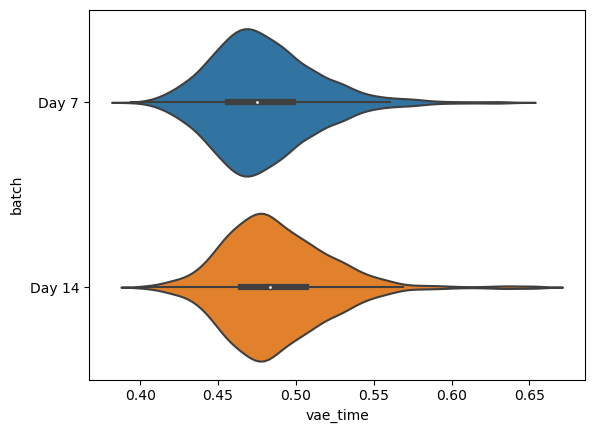

In [28]:
sns.violinplot(y="batch", x=f'{key}_time', data=adata.obs, orient='h');

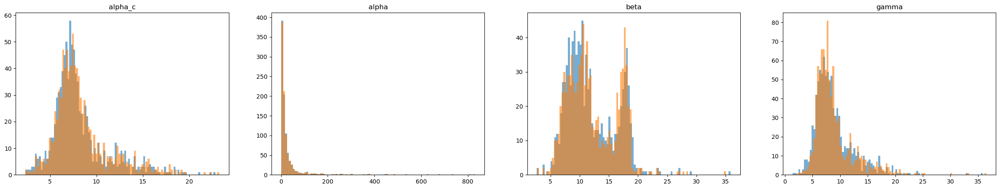

In [29]:
fig, axs = plt.subplots(1, 4, figsize=(30, 5))
axs[0].hist(adata.var[f'{key}_alpha_c_0'], bins=100, alpha=0.6);
axs[0].hist(adata.var[f'{key}_alpha_c_1'], bins=100, alpha=0.6);
axs[0].set_title('alpha_c');
a1 = adata.var[f'{key}_alpha_0'].values
a1 = a1[a1 < np.percentile(a1, 99.5)]
a2 = adata.var[f'{key}_alpha_1'].values
a2 = a2[a2 < np.percentile(a2, 99.5)]
axs[1].hist(a1, bins=100, alpha=0.6);
axs[1].hist(a2, bins=100, alpha=0.6);
axs[1].set_title('alpha');
axs[2].hist(adata.var[f'{key}_beta_0'], bins=100, alpha=0.6);
axs[2].hist(adata.var[f'{key}_beta_1'], bins=100, alpha=0.6);
axs[2].set_title('beta');
axs[3].hist(adata.var[f'{key}_gamma_0'], bins=100, alpha=0.6);
axs[3].hist(adata.var[f'{key}_gamma_1'], bins=100, alpha=0.6);
axs[3].set_title('gamma');

In [30]:
sns.set_theme(style="white", palette='tab10')

In [31]:
adata_copy = adata.copy()

In [32]:
adata_copy.obs['leiden'] = pd.Categorical(adata_copy.obs['leiden'], ['Mast Cells', 'Erythrocyte', 'Granulocyte', 'Platelet', 'Megakaryocyte', 'Prog MK', 'MEP', 'CMP', 'HSC', 'LMPP', 'GMP', 'MDP', 'Monocyte', 'Prog DC', 'DC', 'M1 Macrophage', 'M2 Macrophage'])

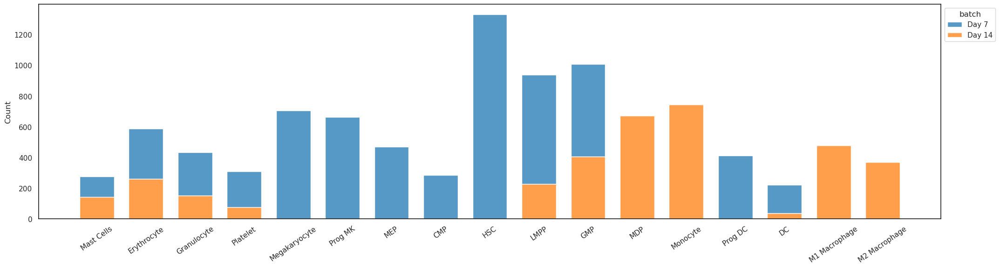

In [33]:
fig, ax = plt.subplots(1, 1, figsize=(25, 6))
sns.histplot(
    data=adata_copy.obs,
    x="leiden",
    hue="batch",
    multiple="stack",
    discrete=True,
    shrink=.7
);
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
ax.tick_params(axis='x', rotation=35)
ax.set_xlabel('');

In [34]:
adata_sub = adata[np.isin(adata.obs['leiden'], ['Erythrocyte', 'Granulocyte', 'Mast Cells', 'Platelet'])].copy()

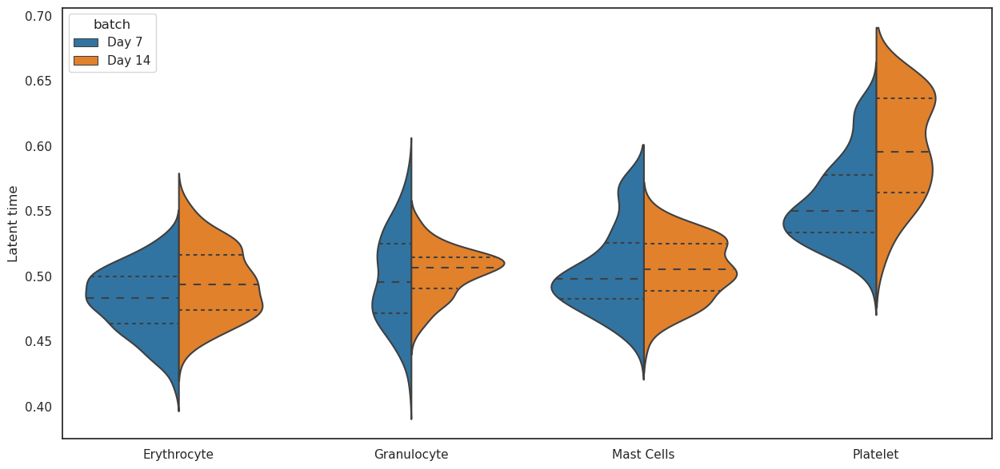

In [35]:
fig, ax = plt.subplots(1, 1, figsize=(15, 7))
sns.violinplot(data=adata_sub.obs, x="leiden", y=f"{key}_time", hue="batch", split=True, inner="quart", linewidth=1.5, ax=ax);
sns.move_legend(ax, "upper left")
ax.set_xlabel('');
ax.set_ylabel('Latent time');

In [36]:
adata_sub = adata[np.isin(adata.obs['leiden'], ['Prog DC', 'Monocyte', 'DC', 'M1 Macrophage', 'M2 Macrophage'])].copy()
adata_sub.obs['leiden'] = pd.Categorical(adata_sub.obs['leiden'], ['Monocyte', 'M2 Macrophage', 'M1 Macrophage', 'Prog DC', 'DC'])

In [37]:
colors = {x:y for x,y in zip(adata.obs['leiden'].cat.categories, adata.uns['leiden_colors'])}

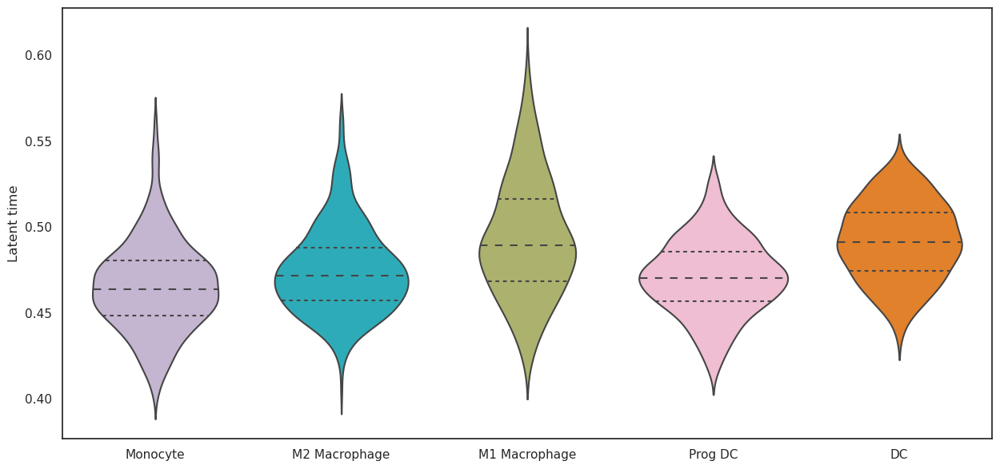

In [38]:
fig, ax = plt.subplots(1, 1, figsize=(15, 7))
sns.violinplot(data=adata_sub.obs, x="leiden", y=f"{key}_time", split=True, inner="quart", linewidth=1.5, palette=colors, ax=ax);
ax.set_xlabel('');
ax.set_ylabel('Latent time');

### Compare Macrophage and DC

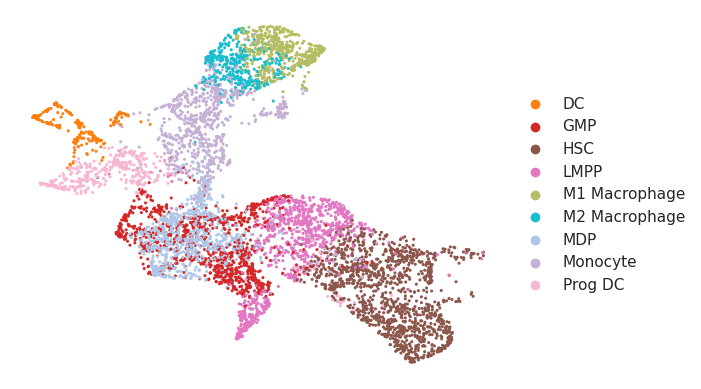

In [39]:
adata_sub = adata[adata.obs['leiden'].isin(['DC', 'GMP', 'HSC', 'LMPP', 'MDP',
                                            'M1 Macrophage', 'M2 Macrophage', 'Monocyte', 'Prog DC'])].copy()
adata_sub = adata_sub[adata_sub.obsm['X_z_umap'][:,0]<np.percentile(adata_sub.obsm['X_z_umap'][:,0], 99.5)].copy()
scv.pl.scatter(adata_sub, basis='z_umap', color='leiden', legend_loc='right', title='')
adata_atac_sub = adata_atac[adata_sub.obs_names,:]

In [40]:
a = np.isin(adata.obs['leiden'], ['M1 Macrophage', 'M2 Macrophage'])
b = np.isin(adata.obs['leiden'], ['DC'])

In [41]:
df_dd_ = vv.model.differential_dynamics(adata, adata_atac, model=model, batch_key='batch', idx1=a, idx2=b, mode='change')

Different batches found in group1 and group2. Sampling pairs regardless of batch conditions.
Using reference batch for latent variable computation.
Using reference batch for latent variable computation.


In [42]:
df_dd_["log10_pscore"] = np.log10(df_dd_["p_v_no_change"])
df_dd_["gene_type"] = "Other"
df_dd_.loc[(df_dd_['log2_diff_v']>3).to_numpy() & (df_dd_['log10_pscore']<np.log10(0.05)).to_numpy(), "gene_type"] = 'LD>3&Pval<0.05'
df_dd_.loc[(df_dd_['log2_diff_v']<-3).to_numpy() & (df_dd_['log10_pscore']<np.log10(0.05)).to_numpy(), "gene_type"] = 'LD<-3&Pval<0.05'
df_dd_['gene_name'] = df_dd_.index
df_dd_.loc[~np.isin(df_dd_['gene_type'], ['LD>3&Pval<0.05', 'LD<-3&Pval<0.05']), 'gene_name'] = np.nan

In [43]:
df_dd_.groupby(['gene_type']).size()

gene_type
LD<-3&Pval<0.05     18
LD>3&Pval<0.05      43
Other              868
dtype: int64

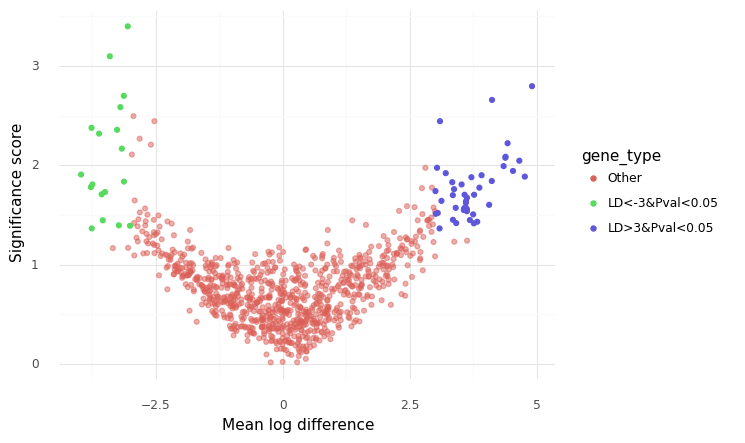

<ggplot: (8763277525179)>

In [44]:
(
    p9.ggplot(df_dd_, p9.aes("log2_diff_v", "-log10_pscore", color="gene_type"))
    + p9.geom_point(
        df_dd_.query("gene_type == 'Other'"), alpha=0.5
    )  # Plot other genes with transparence
    + p9.geom_point(df_dd_.query("gene_type != 'Other'"))
    + p9.labs(x="Mean log difference", y="Significance score")
    + p9.theme_minimal()
)

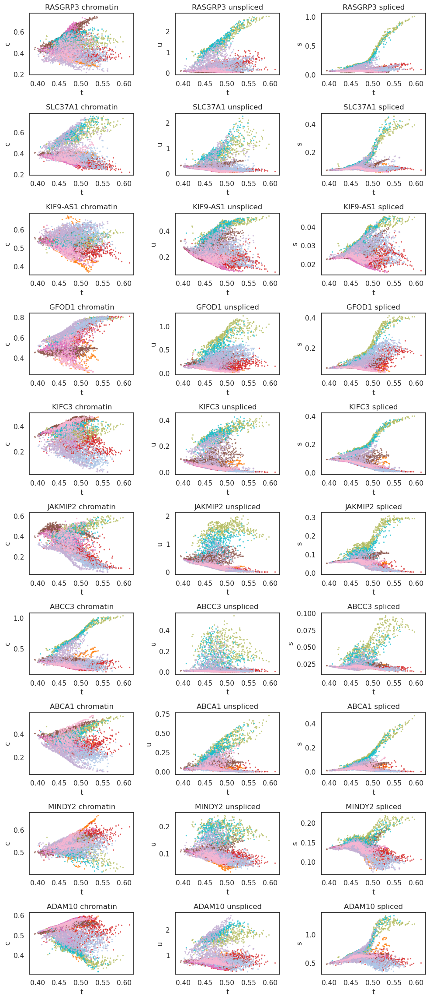

In [45]:
vv.dynamic_plot(adata_sub, adata_atac_sub, df_dd_.sort_values(by=['bayes_factor_v', 'log2_diff_v'], ascending=[False, False])[df_dd_['log2_diff_v']>0].index[:10], color_by='leiden', batch_correction=True)

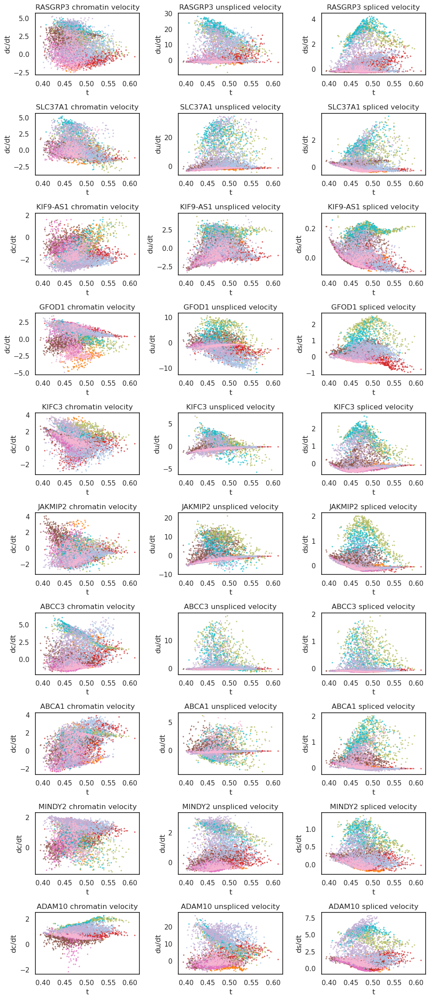

In [46]:
vv.dynamic_plot(adata_sub, adata_atac_sub, df_dd_.sort_values(by=['bayes_factor_v', 'log2_diff_v'], ascending=[False, False])[df_dd_['log2_diff_v']>0].index[:10], color_by='leiden', by='velocity')

In [47]:
adata_copy2 = adata_sub.copy()
adata_copy2.X = adata_copy2.layers[f'{key}_velocity'].copy()

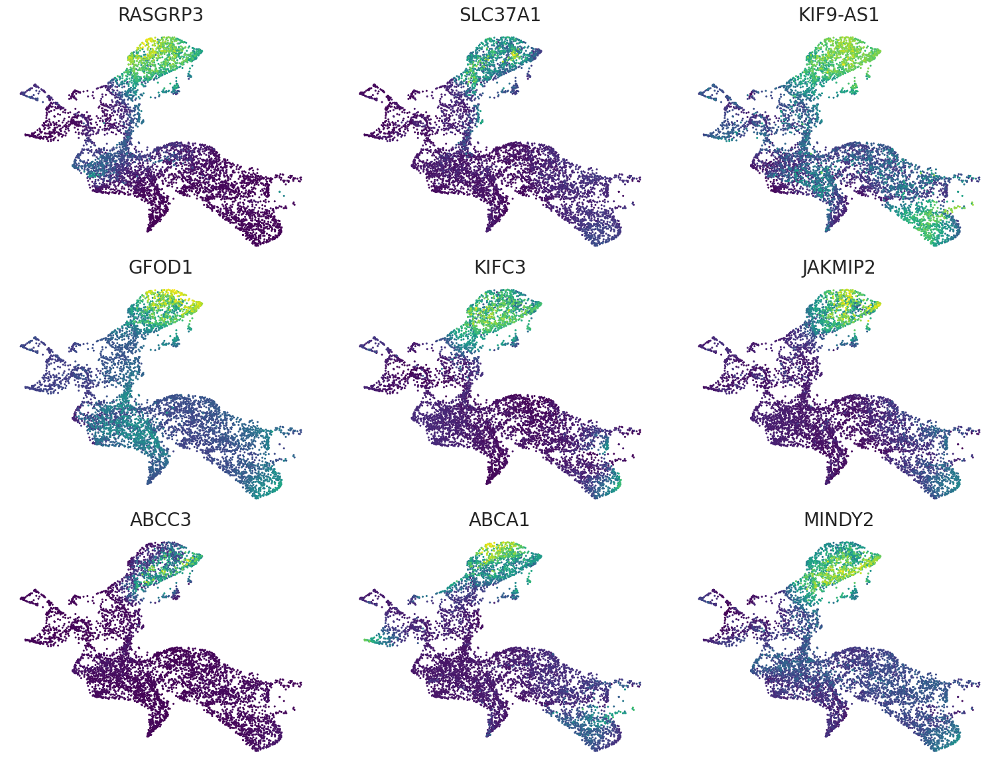

In [48]:
scv.pl.scatter(adata_copy2, basis='z_umap', color=df_dd_.sort_values(by=['bayes_factor_v', 'log2_diff_v'], ascending=[False, False])[df_dd_['log2_diff_v']>0].index[:9], frameon=False, ncols=3, colorbar=False, wspace=0.1, hspace=0.1, fontsize=20, color_map='viridis')

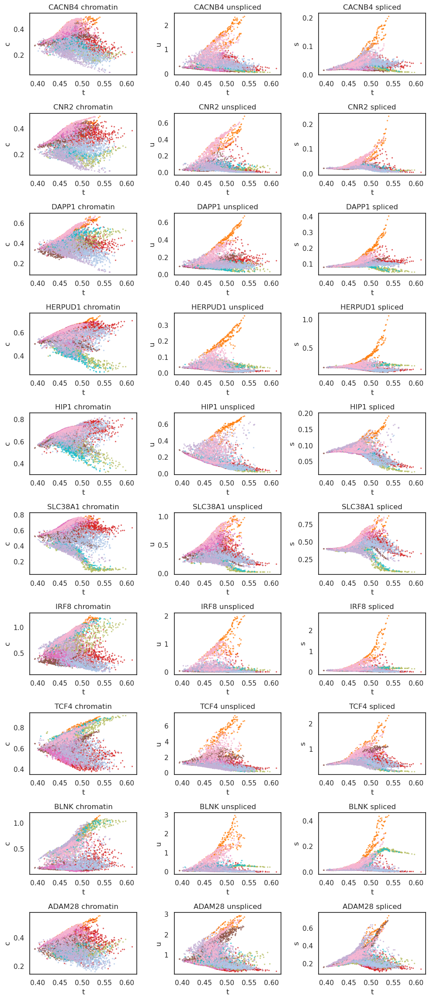

In [49]:
vv.dynamic_plot(adata_sub, adata_atac_sub, df_dd_.sort_values(by=['bayes_factor_v', 'log2_diff_v'], ascending=[False, True])[df_dd_['log2_diff_v']<0].index[:10], color_by='leiden', batch_correction=True)

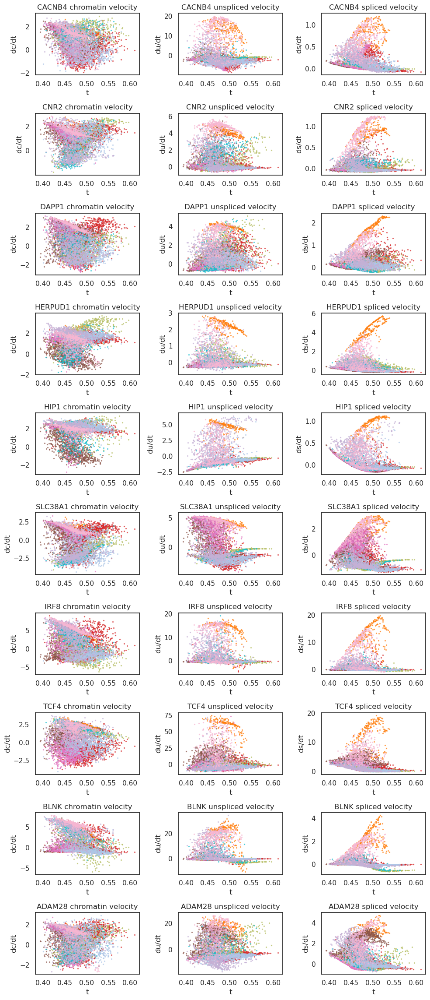

In [50]:
vv.dynamic_plot(adata_sub, adata_atac_sub, df_dd_.sort_values(by=['bayes_factor_v', 'log2_diff_v'], ascending=[False, True])[df_dd_['log2_diff_v']<0].index[:10], color_by='leiden', by='velocity')

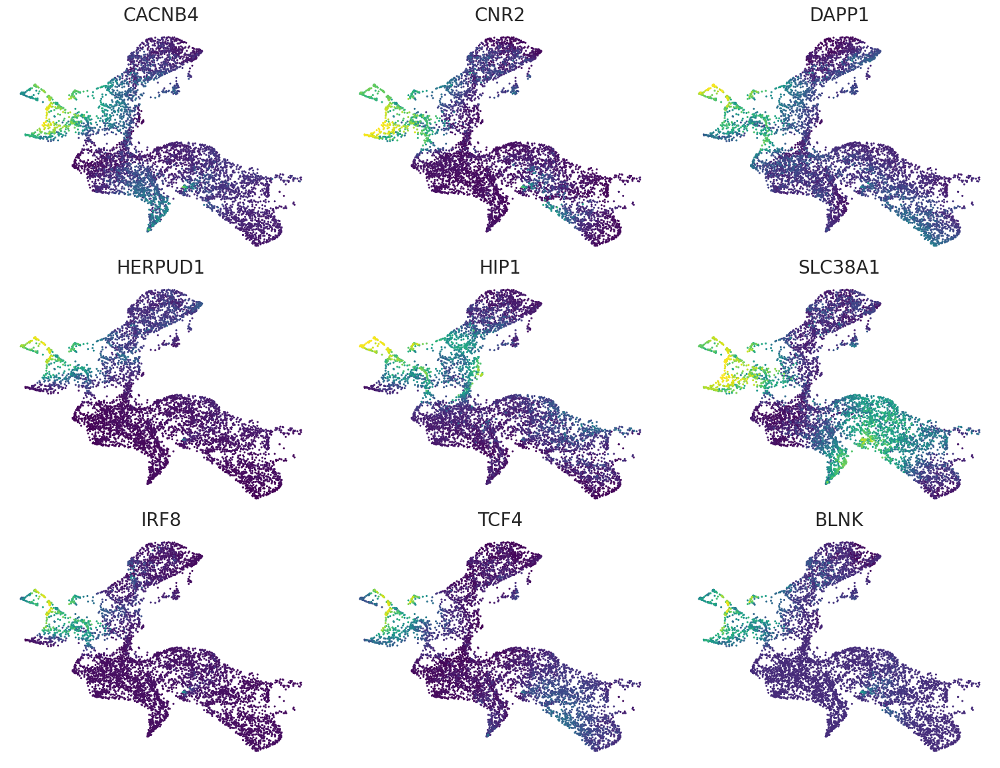

In [51]:
scv.pl.scatter(adata_copy2, basis='z_umap', color=df_dd_.sort_values(by=['bayes_factor_v', 'log2_diff_v'], ascending=[False, True])[df_dd_['log2_diff_v']<0].index[:9], frameon=False, ncols=3, colorbar=False, wspace=0.1, hspace=0.1, fontsize=20, color_map='viridis')

### Mac vs DC plots

In [52]:
color_include = ['Monocyte', 'Prog DC', 'DC', 'M1 Macrophage', 'M2 Macrophage']

In [53]:
df_dd_mac = vv.model.differential_dynamics(adata, adata_atac, model=model, batch_key='batch', idx1=a, idx2=b, mode='change', save_raw=True)

Different batches found in group1 and group2. Sampling pairs regardless of batch conditions.
Using reference batch for latent variable computation.
Using reference batch for latent variable computation.


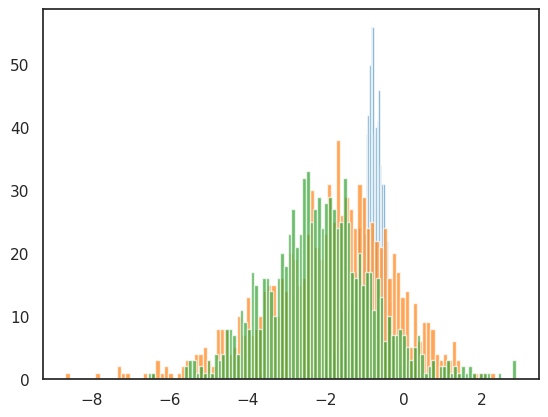

In [54]:
plt.hist(np.log(df_dd_mac['mean_c1']), bins=100, alpha=0.7);
plt.hist(np.log(df_dd_mac['mean_u1']), bins=100, alpha=0.7);
plt.hist(np.log(df_dd_mac['mean_s1']), bins=100, alpha=0.7);

In [55]:
mac_ddg = df_dd_mac.sort_values(by='bayes_factor_v', ascending=False)[(df_dd_mac['log2_diff_v']>0)
                                                                      & (np.log(df_dd_mac['mean_c1'])>-1.5)
                                                                      & (np.log(df_dd_mac['mean_u1'])>-3)
                                                                      & (np.log(df_dd_mac['mean_s1'])>-3)].index
len(mac_ddg)

297

In [56]:
mac_ddg

Index(['RASGRP3', 'SLC37A1', 'GFOD1', 'KIFC3', 'JAKMIP2', 'ABCC3', 'ABCA1',
       'ADAM10', 'MINDY2', 'SLC2A3',
       ...
       'MINPP1', 'CDK6', 'MAN1A1', 'NUCB2', 'MYH10', 'PDZD8', 'CCDC171',
       'TNFAIP8', 'NCOA4', 'CAT'],
      dtype='object', length=297)

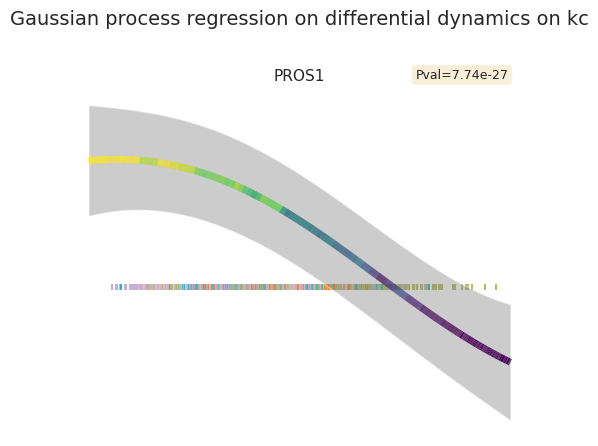

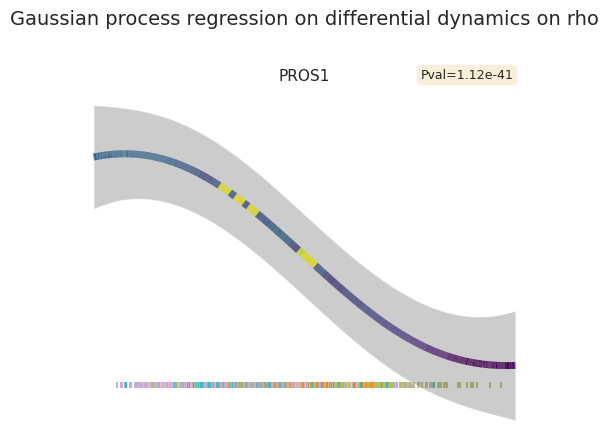

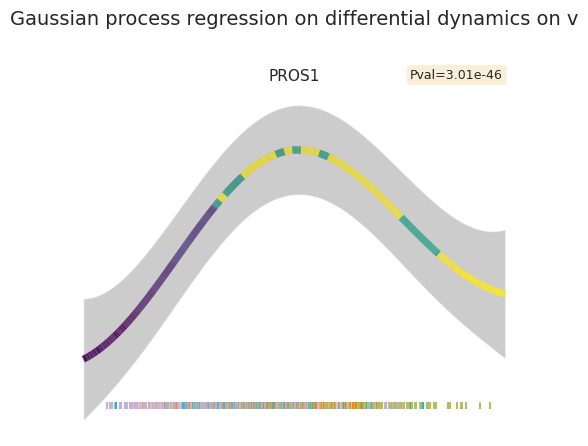

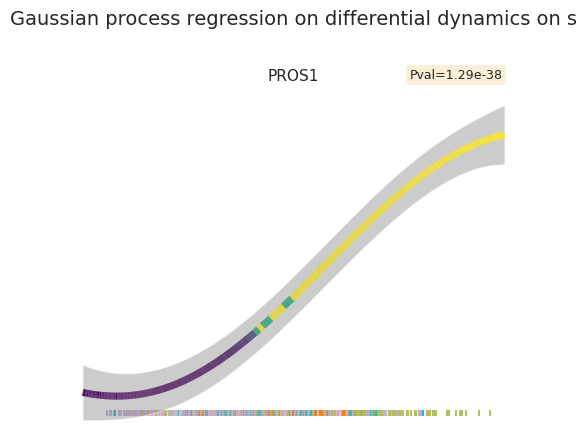

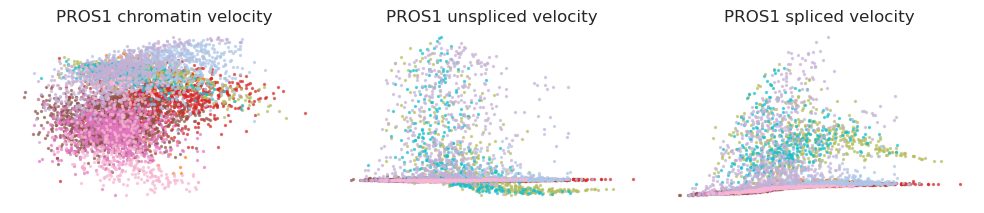

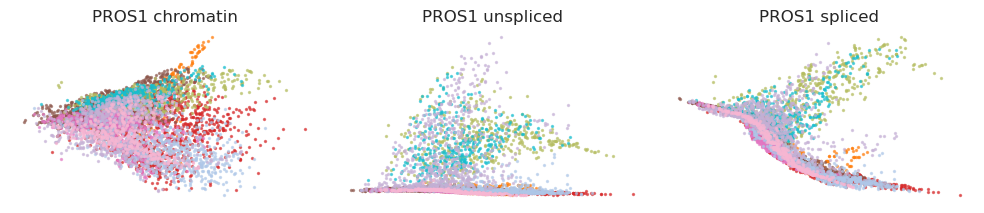

In [57]:
gene = 'PROS1'
vv.differential_dynamics_plot(adata, gene, var='kc', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.differential_dynamics_plot(adata, gene, var='rho', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.differential_dynamics_plot(adata, gene, var='v', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.differential_dynamics_plot(adata, gene, var='s', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.dynamic_plot(adata_sub, adata_atac[adata_sub.obs_names,:], gene, color_by='leiden', by='velocity', axis_on=False, frame_on=False)
vv.dynamic_plot(adata_sub, adata_atac[adata_sub.obs_names,:], gene, color_by='leiden', batch_correction=True, axis_on=False, frame_on=False)

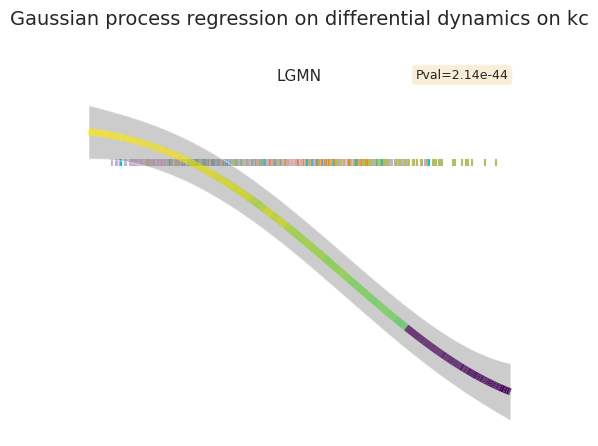

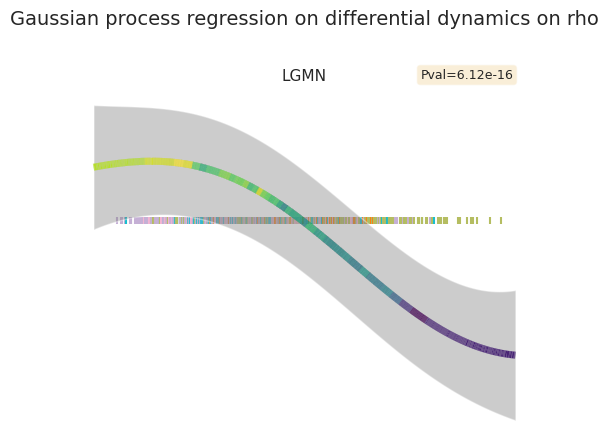

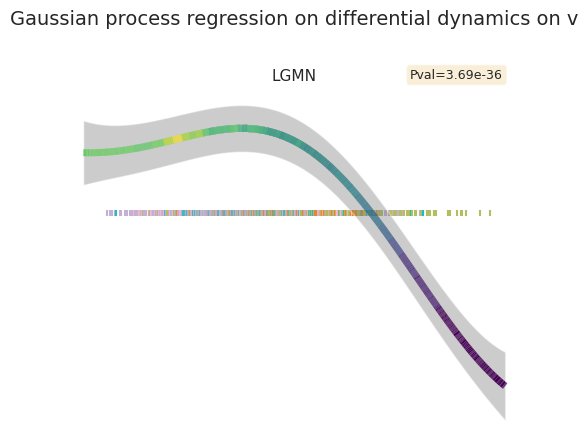

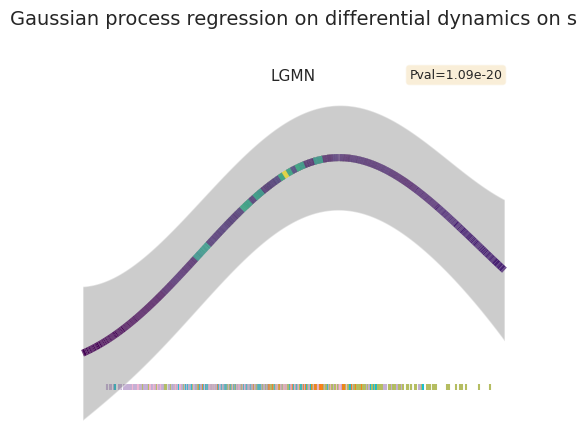

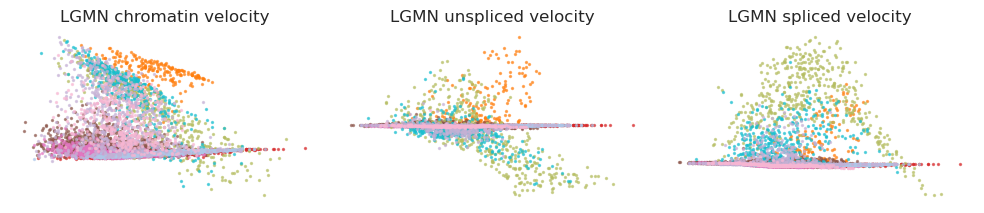

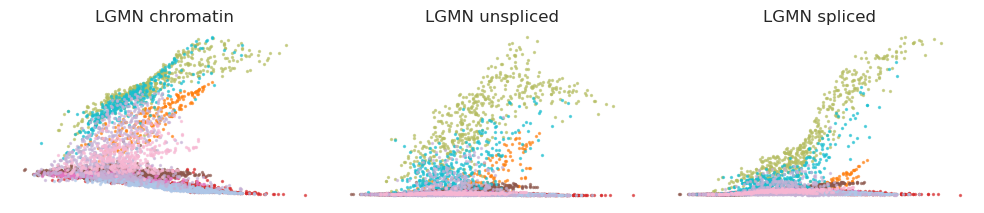

In [58]:
gene = 'LGMN'
vv.differential_dynamics_plot(adata, gene, var='kc', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.differential_dynamics_plot(adata, gene, var='rho', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.differential_dynamics_plot(adata, gene, var='v', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.differential_dynamics_plot(adata, gene, var='s', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.dynamic_plot(adata_sub, adata_atac[adata_sub.obs_names,:], gene, color_by='leiden', by='velocity', axis_on=False, frame_on=False)
vv.dynamic_plot(adata_sub, adata_atac[adata_sub.obs_names,:], gene, color_by='leiden', batch_correction=True, axis_on=False, frame_on=False)

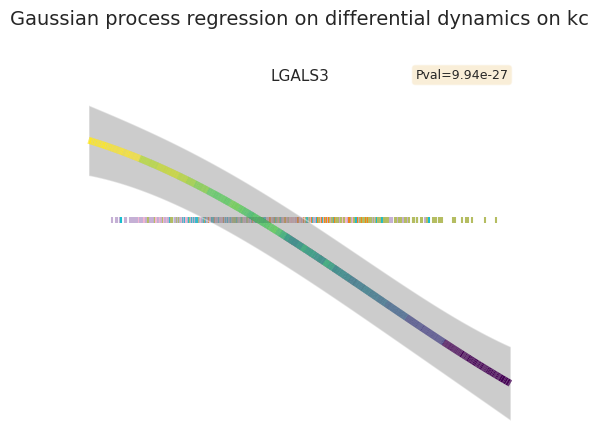

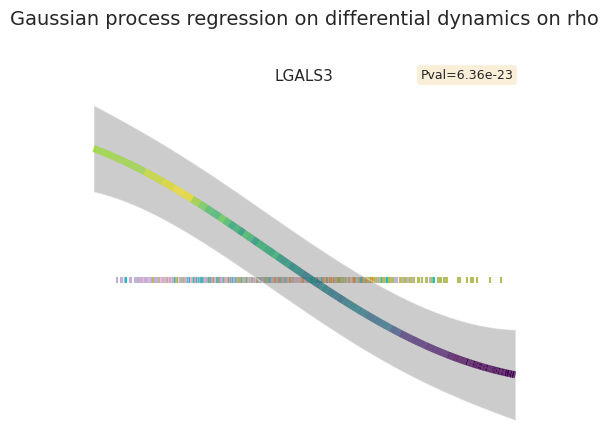

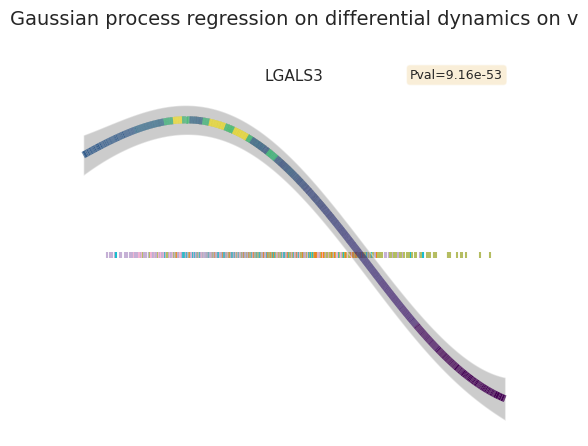

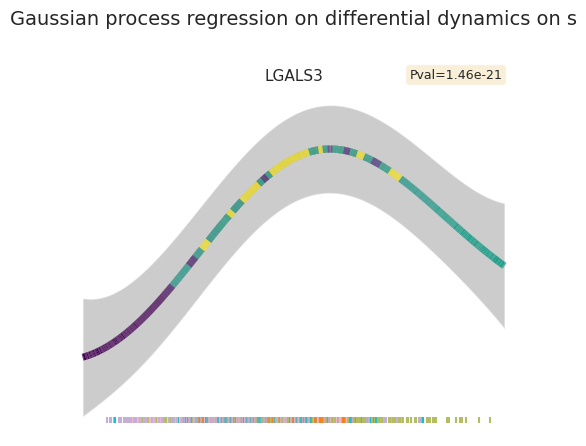

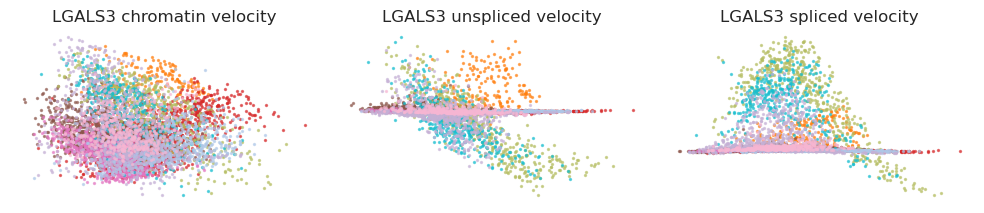

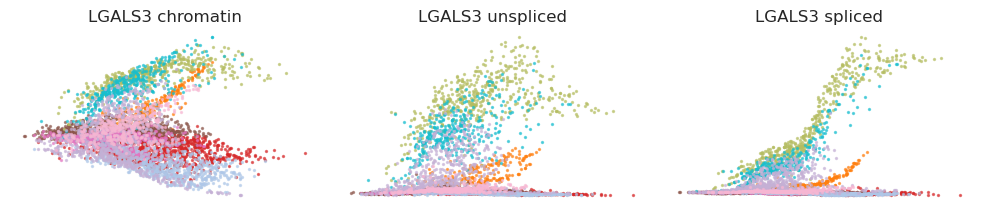

In [59]:
gene = 'LGALS3'
vv.differential_dynamics_plot(adata, gene, var='kc', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.differential_dynamics_plot(adata, gene, var='rho', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.differential_dynamics_plot(adata, gene, var='v', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.differential_dynamics_plot(adata, gene, var='s', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.dynamic_plot(adata_sub, adata_atac[adata_sub.obs_names,:], gene, color_by='leiden', by='velocity', axis_on=False, frame_on=False)
vv.dynamic_plot(adata_sub, adata_atac[adata_sub.obs_names,:], gene, color_by='leiden', batch_correction=True, axis_on=False, frame_on=False)

In [60]:
df_dd_dc = vv.model.differential_dynamics(adata, adata_atac, model=model, batch_key='batch', idx1=b, idx2=a, mode='change', save_raw=True)

Different batches found in group1 and group2. Sampling pairs regardless of batch conditions.
Using reference batch for latent variable computation.
Using reference batch for latent variable computation.


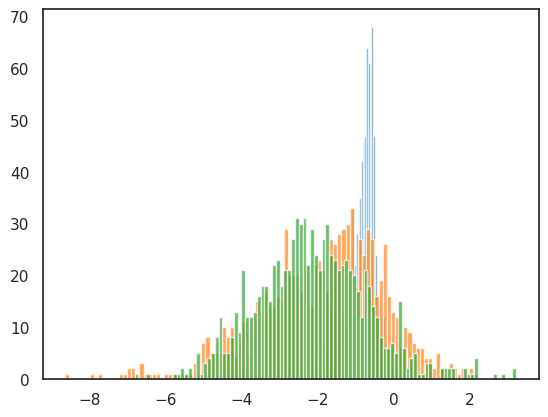

In [61]:
plt.hist(np.log(df_dd_dc['mean_c1']), bins=100, alpha=0.7);
plt.hist(np.log(df_dd_dc['mean_u1']), bins=100, alpha=0.7);
plt.hist(np.log(df_dd_dc['mean_s1']), bins=100, alpha=0.7);

In [62]:
dc_ddg = df_dd_dc.sort_values(by='bayes_factor_v', ascending=False)[(df_dd_dc['log2_diff_v']>0)
                                                                    & (np.log(df_dd_dc['mean_c1'])>-1.5)
                                                                    & (np.log(df_dd_dc['mean_u1'])>-3)
                                                                    & (np.log(df_dd_dc['mean_s1'])>-3)].index
len(dc_ddg)

307

In [63]:
dc_ddg

Index(['CACNB4', 'TCF4', 'CNR2', 'DAPP1', 'IRF8', 'OTULINL', 'BLNK', 'HERPUD1',
       'HIP1', 'IPCEF1',
       ...
       'LINC00662', 'LPXN', 'DIAPH1', 'AIG1', 'DEPTOR', 'LMO4', 'ATP9B',
       'ZNF521', 'PRKAR2B', 'DDX10'],
      dtype='object', length=307)

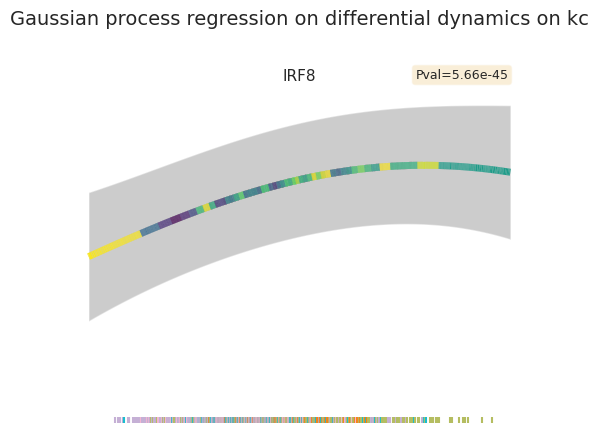

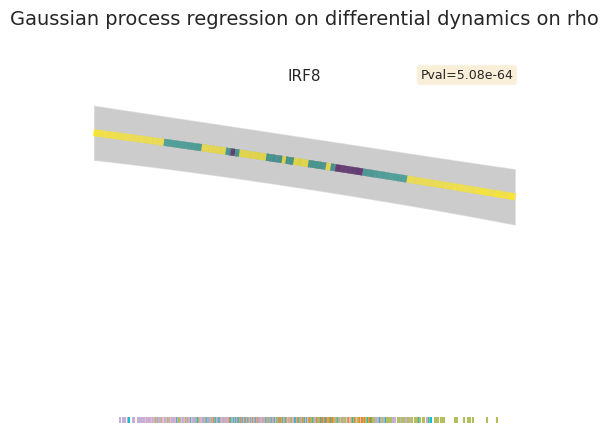

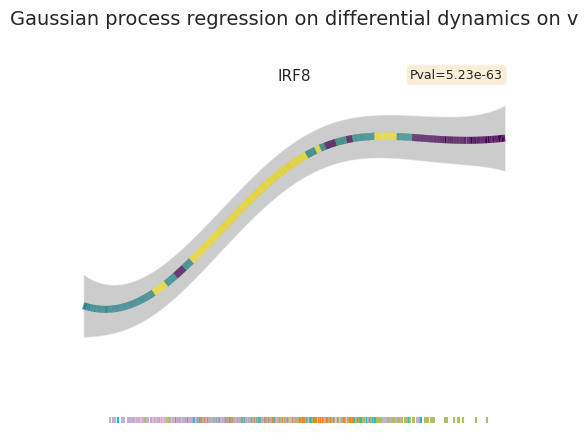

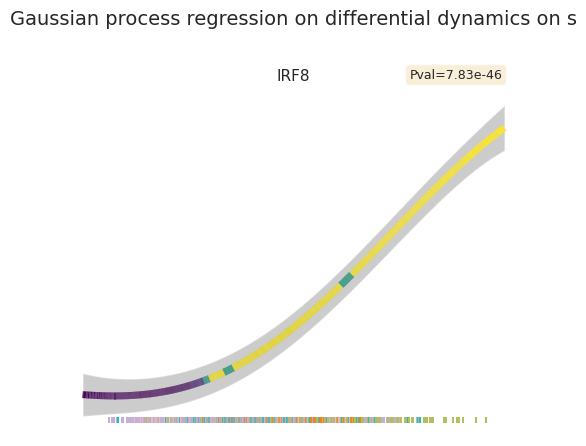

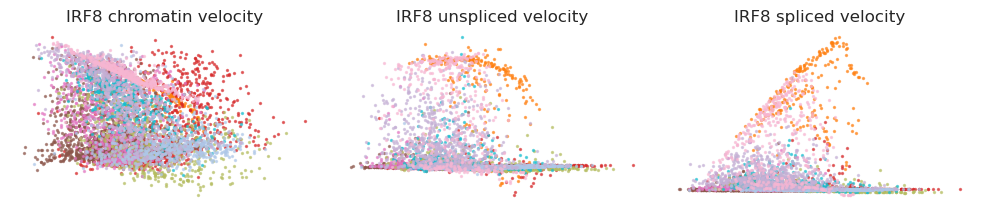

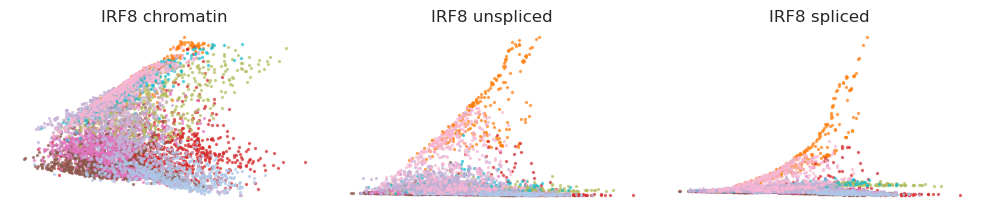

In [64]:
gene = 'IRF8'
vv.differential_dynamics_plot(adata, gene, var='kc', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.differential_dynamics_plot(adata, gene, var='rho', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.differential_dynamics_plot(adata, gene, var='v', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.differential_dynamics_plot(adata, gene, var='s', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.dynamic_plot(adata_sub, adata_atac[adata_sub.obs_names,:], gene, color_by='leiden', by='velocity', axis_on=False, frame_on=False)
vv.dynamic_plot(adata_sub, adata_atac[adata_sub.obs_names,:], gene, color_by='leiden', batch_correction=True, axis_on=False, frame_on=False)

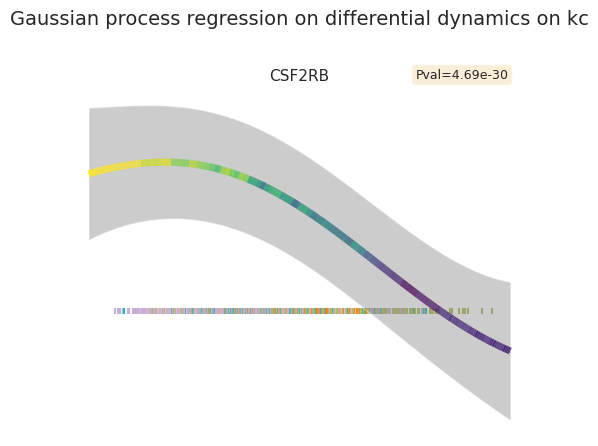

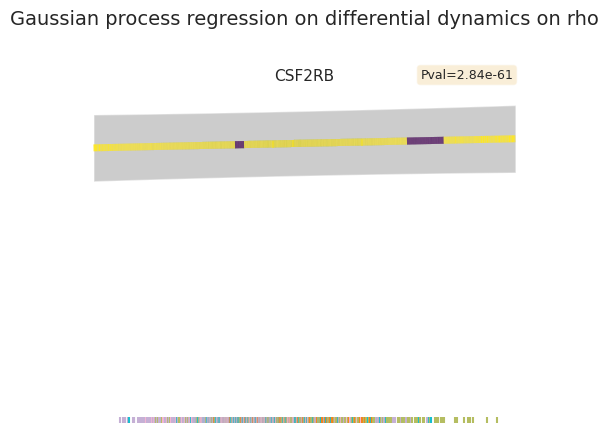

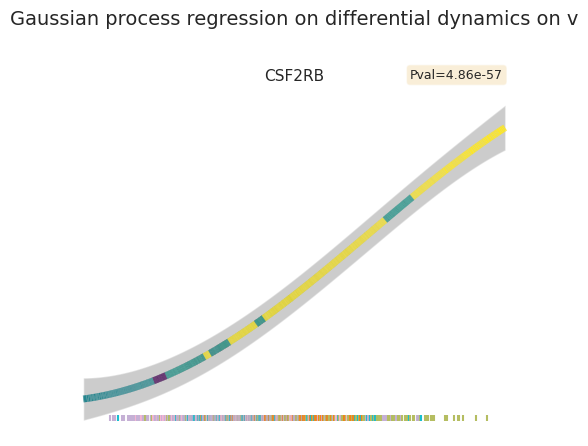

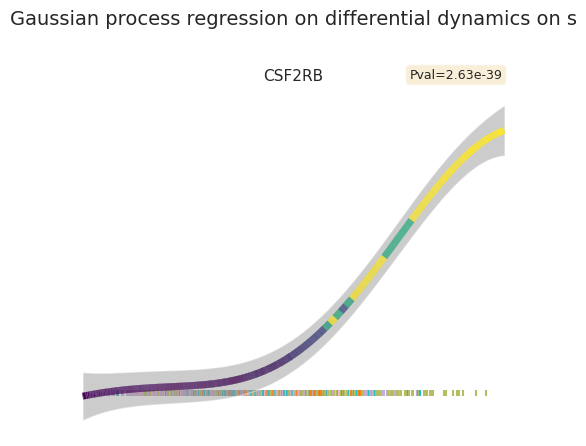

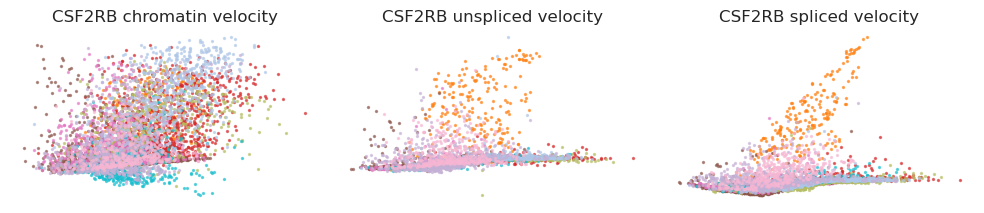

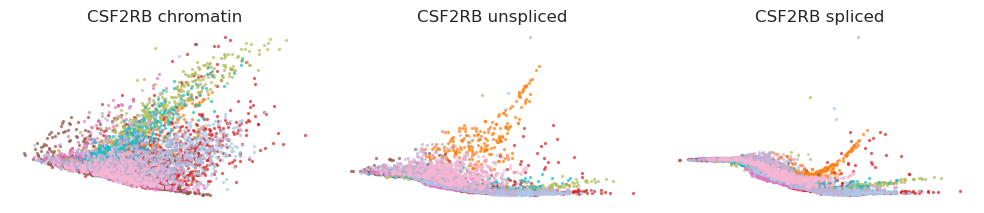

In [65]:
gene = 'CSF2RB'
vv.differential_dynamics_plot(adata, gene, var='kc', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.differential_dynamics_plot(adata, gene, var='rho', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.differential_dynamics_plot(adata, gene, var='v', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.differential_dynamics_plot(adata, gene, var='s', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.dynamic_plot(adata_sub, adata_atac[adata_sub.obs_names,:], gene, color_by='leiden', by='velocity', axis_on=False, frame_on=False)
vv.dynamic_plot(adata_sub, adata_atac[adata_sub.obs_names,:], gene, color_by='leiden', batch_correction=True, axis_on=False, frame_on=False)

### Compare Eryth vs MK

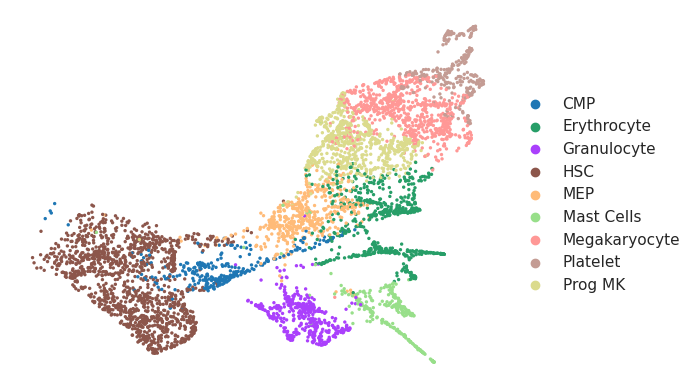

In [66]:
adata_sub2 = adata[adata.obs['leiden'].isin(['CMP', 'Erythrocyte', 'Granulocyte', 'HSC', 'MEP',
                                             'Mast Cells', 'Megakaryocyte', 'Platelet', 'Prog MK'])].copy()
adata_sub2 = adata_sub2[adata_sub2.obsm['X_z_umap'][:,0]>np.percentile(adata_sub2.obsm['X_z_umap'][:,0], 0.28)].copy()
scv.pl.scatter(adata_sub2, basis='z_umap', color='leiden', legend_loc='right', title='')
adata_atac_sub2 = adata_atac[adata_sub2.obs_names,:]

In [67]:
a = np.isin(adata.obs['leiden'], ['Megakaryocyte', 'Platelet'])
b = np.isin(adata.obs['leiden'], ['Erythrocyte'])

In [68]:
df_dd_ = vv.model.differential_dynamics(adata, adata_atac, model=model, batch_key='batch', idx1=a, idx2=b, mode='change')

Using reference batch for latent variable computation.
Using reference batch for latent variable computation.


In [69]:
df_dd_["log10_pscore"] = np.log10(df_dd_["p_v_no_change"])
df_dd_["gene_type"] = "Other"
df_dd_.loc[(df_dd_['log2_diff_v']>4).to_numpy() & (df_dd_['log10_pscore']<np.log10(0.05)).to_numpy(), "gene_type"] = 'LD>4&Pval<0.05'
df_dd_.loc[(df_dd_['log2_diff_v']<-2).to_numpy() & (df_dd_['log10_pscore']<np.log10(0.05)).to_numpy(), "gene_type"] = 'LD<-2&Pval<0.05'
df_dd_['gene_name'] = df_dd_.index
df_dd_.loc[~np.isin(df_dd_['gene_type'], ['LD>3&Pval<0.05', 'LD<-3&Pval<0.05']), 'gene_name'] = np.nan

In [70]:
df_dd_.groupby(['gene_type']).size()

gene_type
LD<-2&Pval<0.05     27
LD>4&Pval<0.05      40
Other              862
dtype: int64

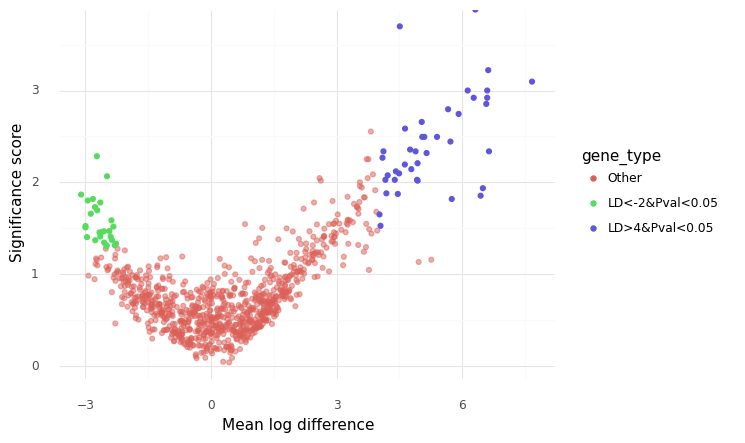

<ggplot: (8763341187045)>

In [71]:
(
    p9.ggplot(df_dd_, p9.aes("log2_diff_v", "-log10_pscore", color="gene_type"))
    + p9.geom_point(
        df_dd_.query("gene_type == 'Other'"), alpha=0.5
    )  # Plot other genes with transparence
    + p9.geom_point(df_dd_.query("gene_type != 'Other'"))
    + p9.labs(x="Mean log difference", y="Significance score")
    + p9.theme_minimal()
)

In [72]:
adata_copy2 = adata_sub2.copy()
adata_copy2.X = adata_copy2.layers[f'{key}_velocity'].copy()

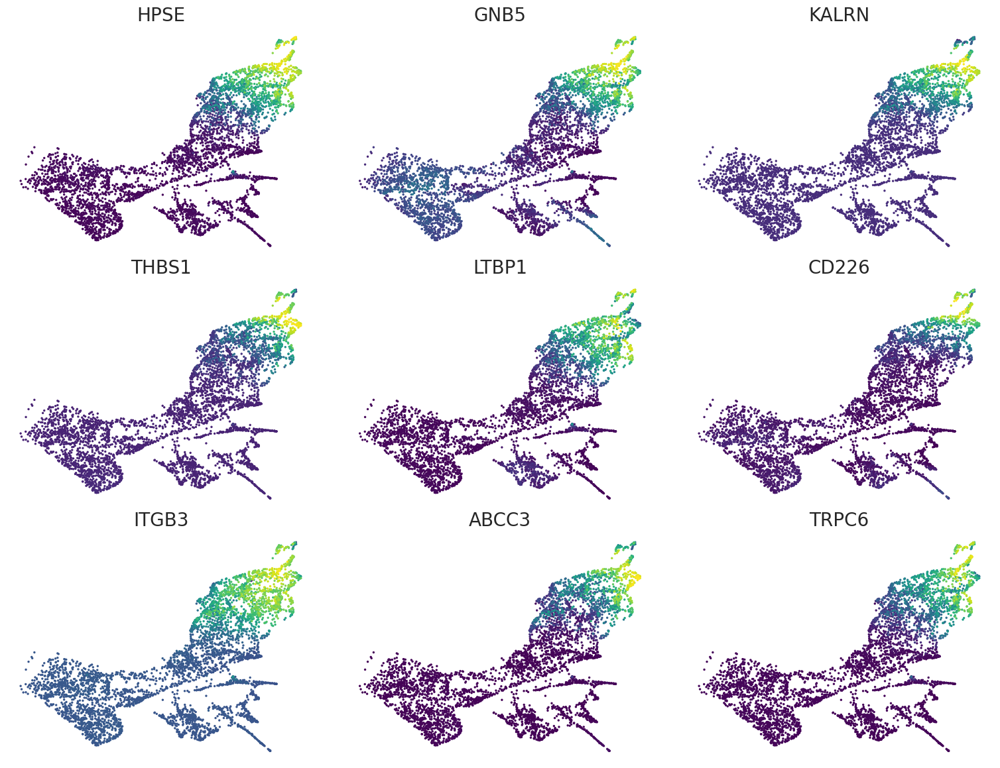

In [73]:
scv.pl.scatter(adata_copy2, basis='z_umap', color=df_dd_.sort_values(by=['bayes_factor_v', 'log2_diff_v'], ascending=[False, False])[df_dd_['log2_diff_v']>0].index[:9], frameon=False, ncols=3, colorbar=False, wspace=0.1, hspace=0.1, fontsize=20, color_map='viridis')

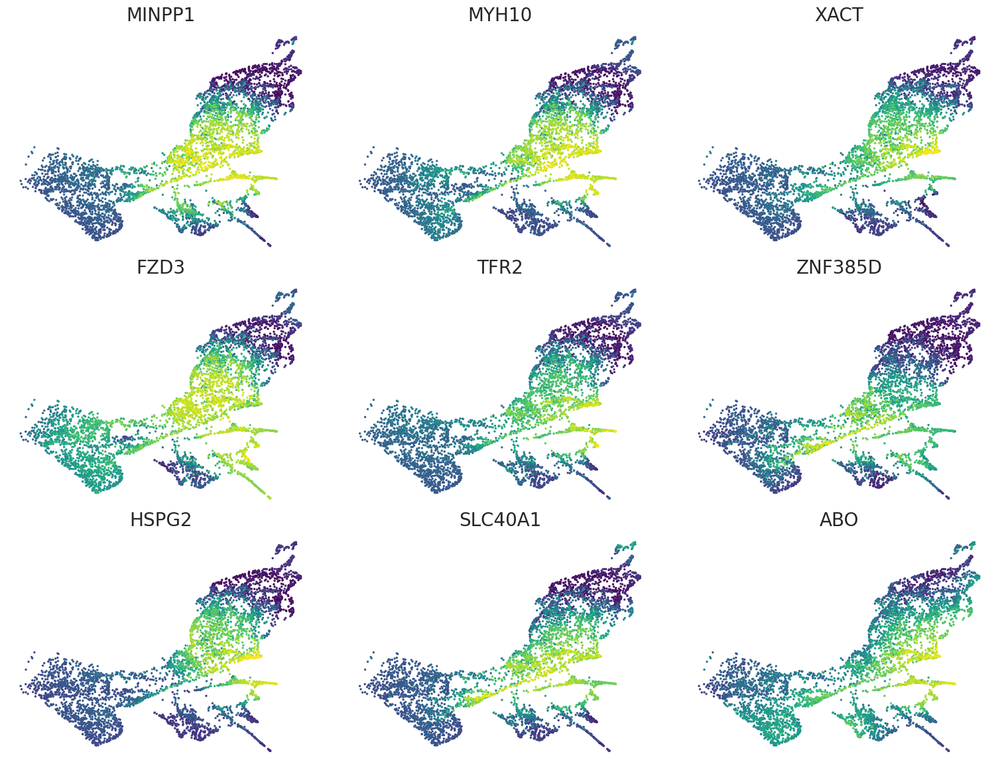

In [74]:
scv.pl.scatter(adata_copy2, basis='z_umap', color=df_dd_.sort_values(by=['bayes_factor_v', 'log2_diff_v'], ascending=[False, True])[df_dd_['log2_diff_v']<0].index[:9], frameon=False, ncols=3, colorbar=False, wspace=0.1, hspace=0.1, fontsize=20, color_map='viridis')

In [75]:
color_include = ['Erythrocyte', 'MEP', 'Megakaryocyte', 'Prog MK', 'Platelet']

In [76]:
df_dd_mk = vv.model.differential_dynamics(adata, adata_atac, model=model, batch_key='batch', idx1=a, idx2=b, mode='change', save_raw=True)

Using reference batch for latent variable computation.
Using reference batch for latent variable computation.


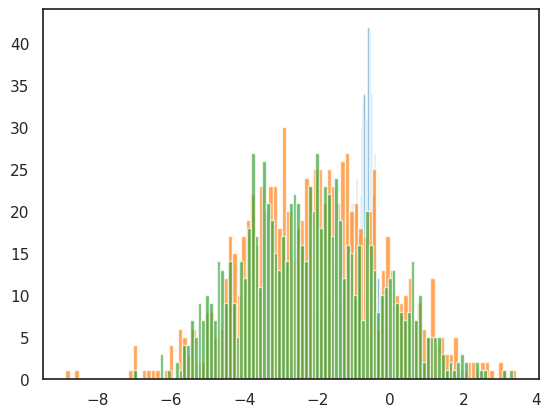

In [77]:
plt.hist(np.log(df_dd_mk['mean_c1']), bins=100, alpha=0.7);
plt.hist(np.log(df_dd_mk['mean_u1']), bins=100, alpha=0.7);
plt.hist(np.log(df_dd_mk['mean_s1']), bins=100, alpha=0.7);

In [78]:
mk_ddg = df_dd_mk.sort_values(by='bayes_factor_v', ascending=False)[(df_dd_mk['log2_diff_v']>0)
                                                                    & (np.log(df_dd_mk['mean_c1'])>-1)
                                                                    & (np.log(df_dd_mk['mean_u1'])>-3)
                                                                    & (np.log(df_dd_mk['mean_s1'])>-3)].index
len(mk_ddg)

227

In [79]:
mk_ddg

Index(['HPSE', 'GNB5', 'KALRN', 'THBS1', 'LTBP1', 'ABCC3', 'ITGB3', 'TRPC6',
       'ITGA6', 'SH3PXD2A',
       ...
       'CENPF', 'PXK', 'NUCB2', 'SPINT2', 'ATP10D', 'SCAPER', 'NT5C3A',
       'B4GALT5', 'SLC12A2', 'TCTN3'],
      dtype='object', length=227)

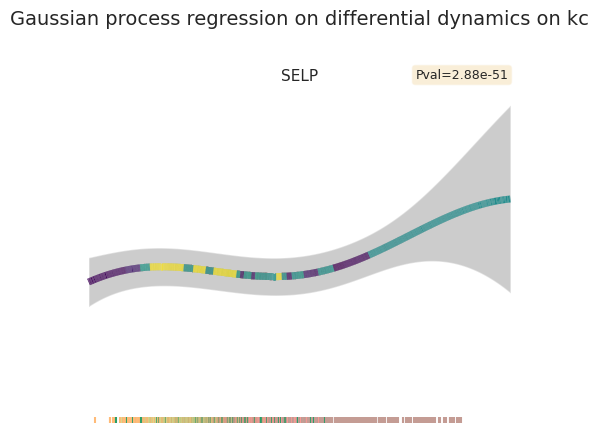

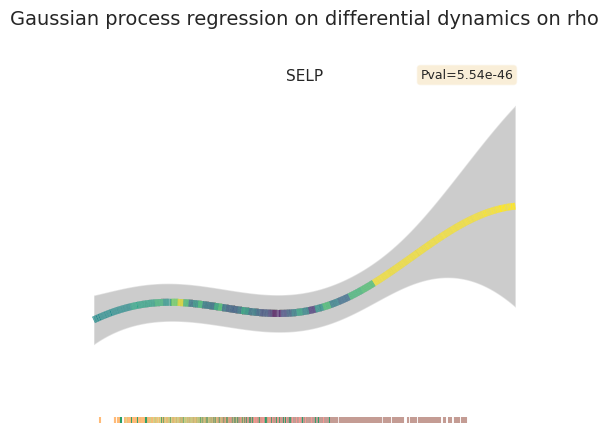

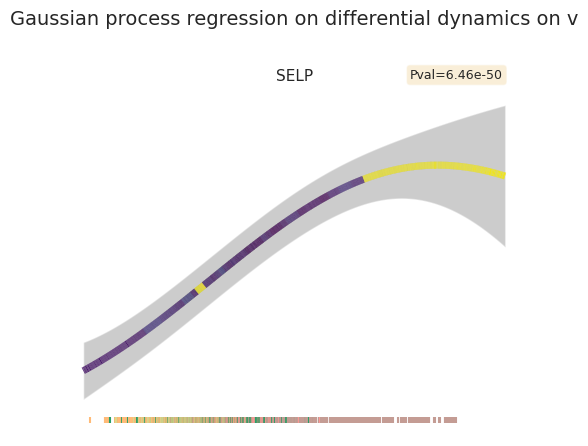

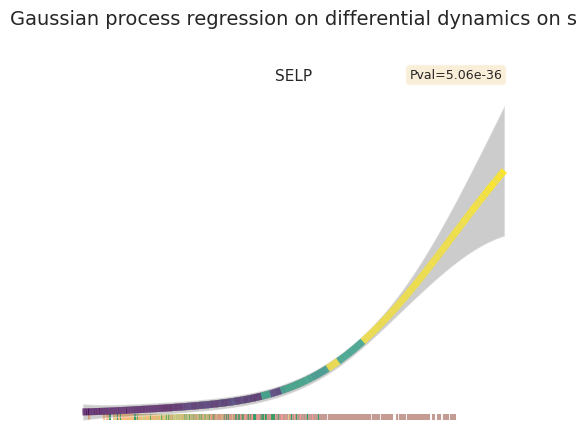

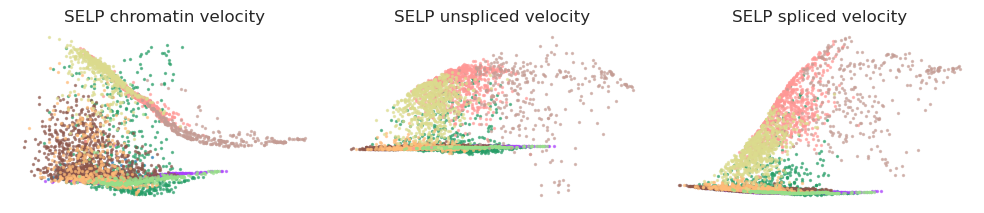

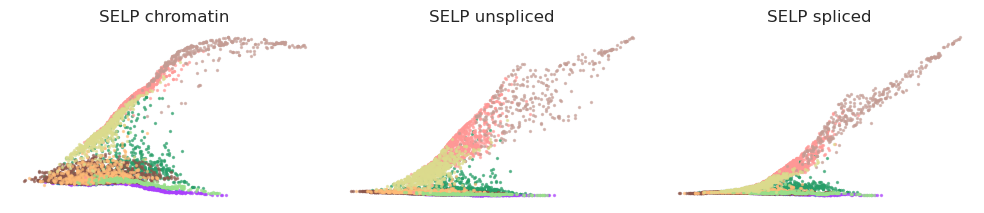

In [80]:
gene = 'SELP'
vv.differential_dynamics_plot(adata, gene, var='kc', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.differential_dynamics_plot(adata, gene, var='rho', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.differential_dynamics_plot(adata, gene, var='v', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.differential_dynamics_plot(adata, gene, var='s', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.dynamic_plot(adata_sub2, adata_atac[adata_sub2.obs_names,:], gene, color_by='leiden', by='velocity', axis_on=False, frame_on=False)
vv.dynamic_plot(adata_sub2, adata_atac[adata_sub2.obs_names,:], gene, color_by='leiden', batch_correction=True, axis_on=False, frame_on=False)

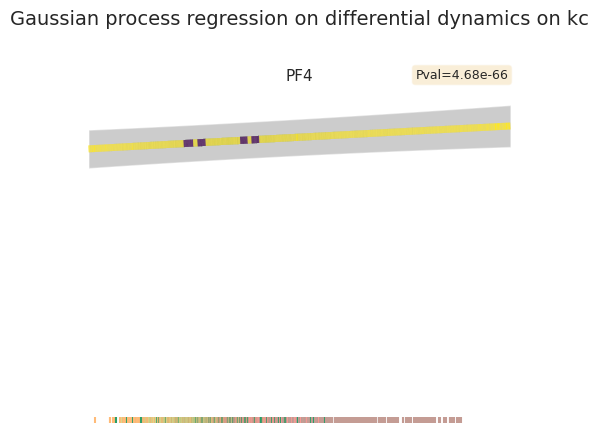

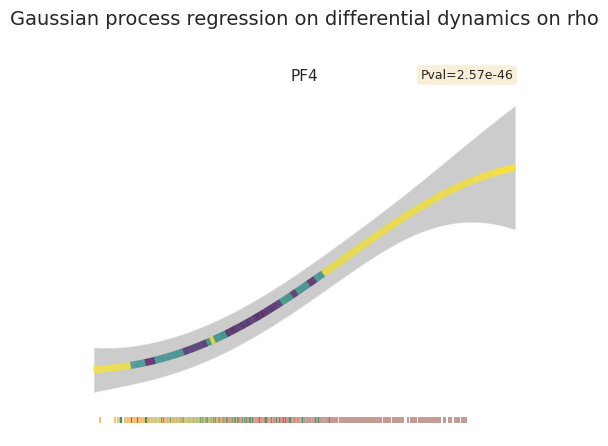

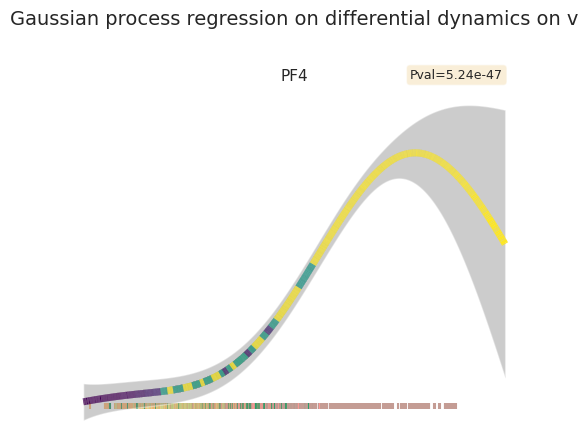

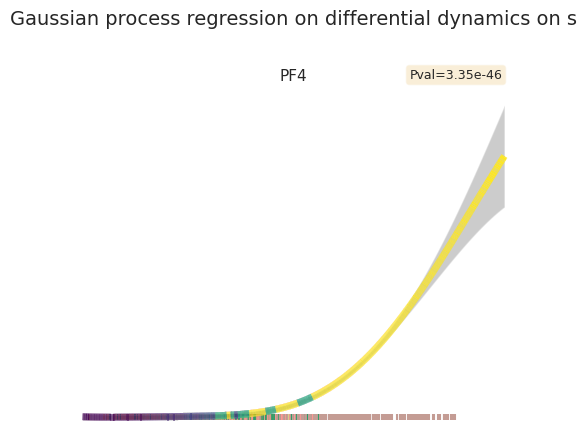

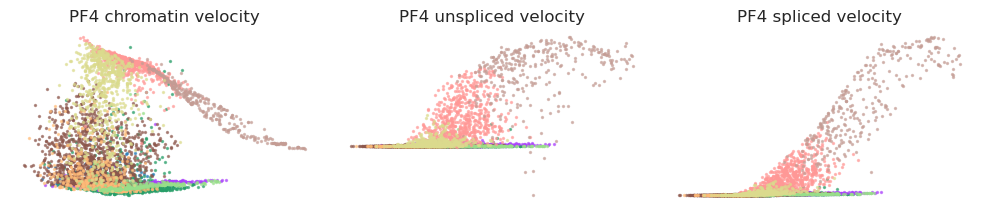

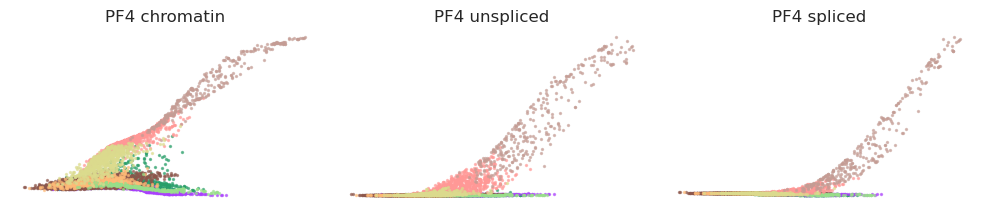

In [81]:
gene = 'PF4'
vv.differential_dynamics_plot(adata, gene, var='kc', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.differential_dynamics_plot(adata, gene, var='rho', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.differential_dynamics_plot(adata, gene, var='v', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.differential_dynamics_plot(adata, gene, var='s', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.dynamic_plot(adata_sub2, adata_atac[adata_sub2.obs_names,:], gene, color_by='leiden', by='velocity', axis_on=False, frame_on=False)
vv.dynamic_plot(adata_sub2, adata_atac[adata_sub2.obs_names,:], gene, color_by='leiden', batch_correction=True, axis_on=False, frame_on=False)

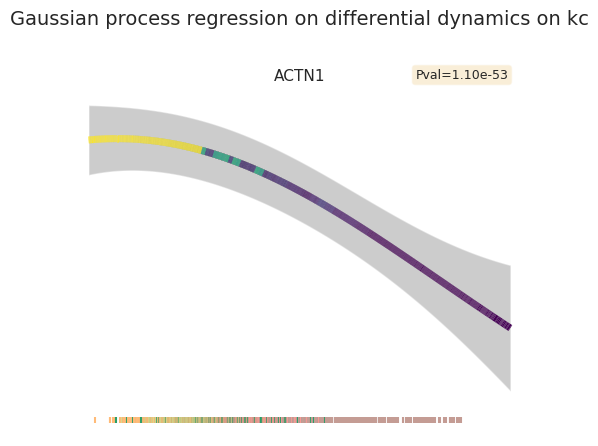

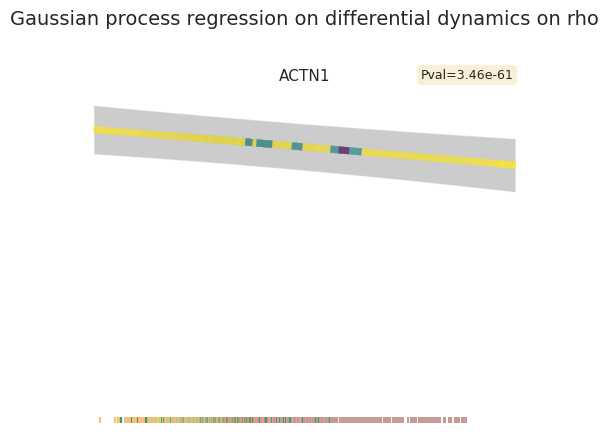

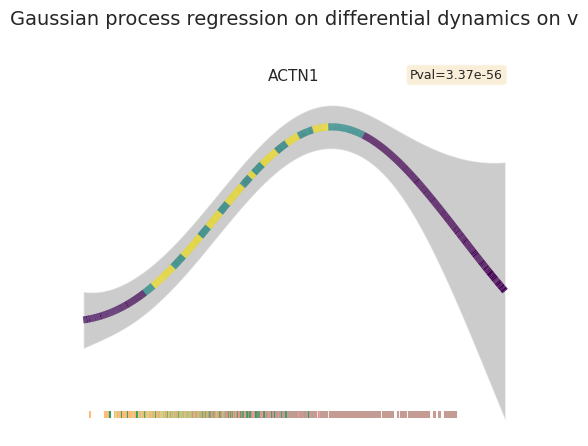

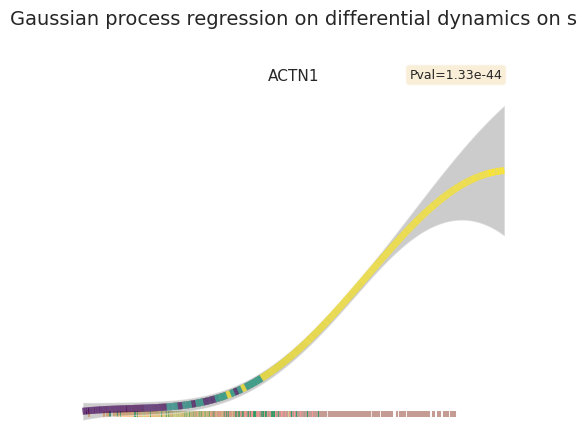

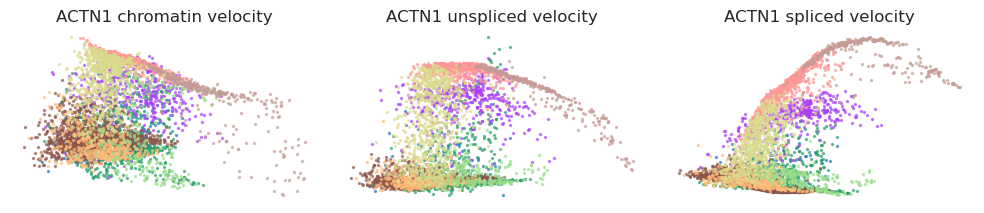

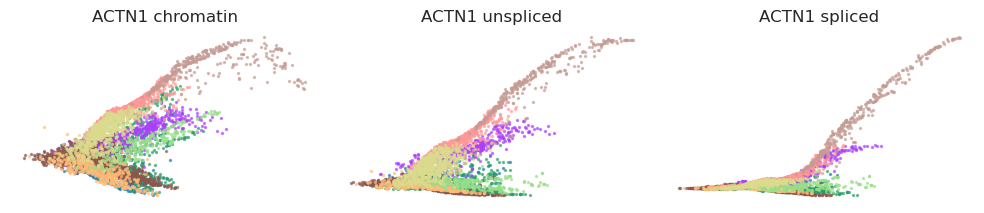

In [82]:
gene = 'ACTN1'
vv.differential_dynamics_plot(adata, gene, var='kc', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.differential_dynamics_plot(adata, gene, var='rho', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.differential_dynamics_plot(adata, gene, var='v', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.differential_dynamics_plot(adata, gene, var='s', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.dynamic_plot(adata_sub2, adata_atac[adata_sub2.obs_names,:], gene, color_by='leiden', by='velocity', axis_on=False, frame_on=False)
vv.dynamic_plot(adata_sub2, adata_atac[adata_sub2.obs_names,:], gene, color_by='leiden', batch_correction=True, axis_on=False, frame_on=False)

In [83]:
df_dd_rb = vv.model.differential_dynamics(adata, adata_atac, model=model, batch_key='batch', idx1=b, idx2=a, mode='change', save_raw=True)

Using reference batch for latent variable computation.
Using reference batch for latent variable computation.


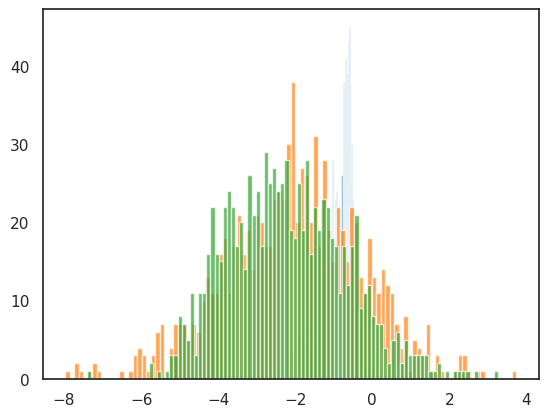

In [84]:
plt.hist(np.log(df_dd_rb['mean_c1']), bins=100, alpha=0.7);
plt.hist(np.log(df_dd_rb['mean_u1']), bins=100, alpha=0.7);
plt.hist(np.log(df_dd_rb['mean_s1']), bins=100, alpha=0.7);

In [85]:
rb_ddg = df_dd_rb.sort_values(by='bayes_factor_v', ascending=False)[(df_dd_rb['log2_diff_v']>0)
                                                                    & (np.log(df_dd_rb['mean_c1'])>-1)
                                                                    & (np.log(df_dd_rb['mean_u1'])>-3)
                                                                    & (np.log(df_dd_rb['mean_s1'])>-3)].index
len(rb_ddg)

200

In [86]:
rb_ddg

Index(['MINPP1', 'MYH10', 'FZD3', 'TFR2', 'XACT', 'HSPG2', 'EMID1', 'SLC40A1',
       'DEPTOR', 'SLC12A6',
       ...
       'TCF4', 'NCOA4', 'DDX10', 'NLN', 'MALT1', 'ASPH', 'BMP2K', 'PDE7A',
       'ATP9B', 'FDX1'],
      dtype='object', length=200)

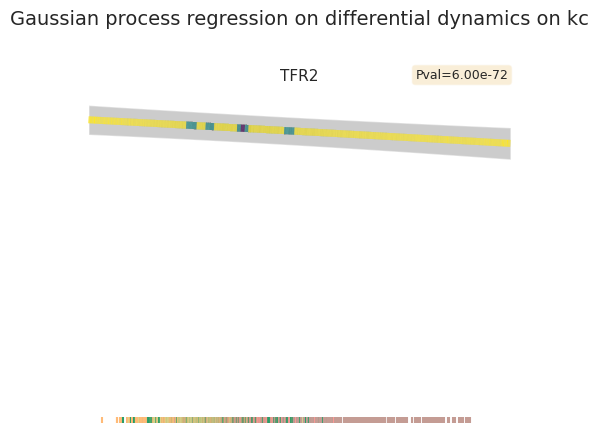

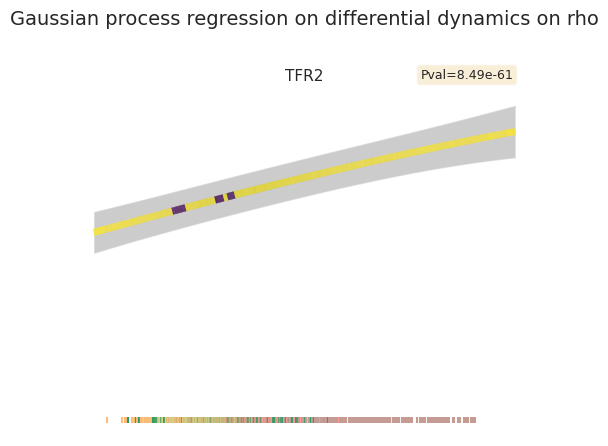

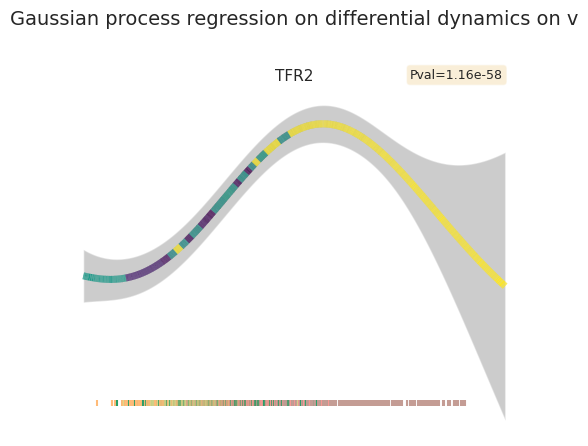

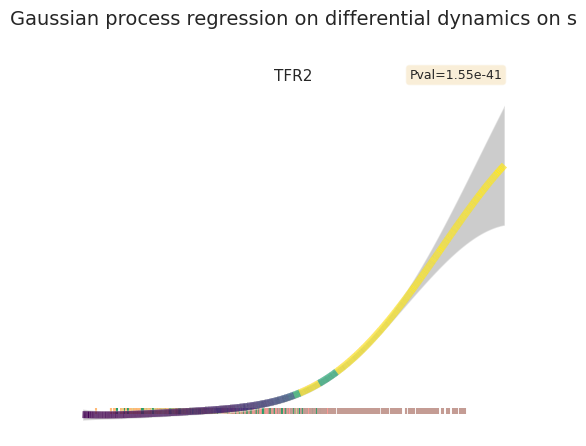

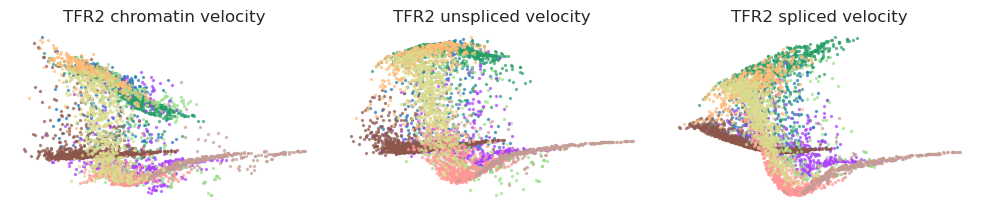

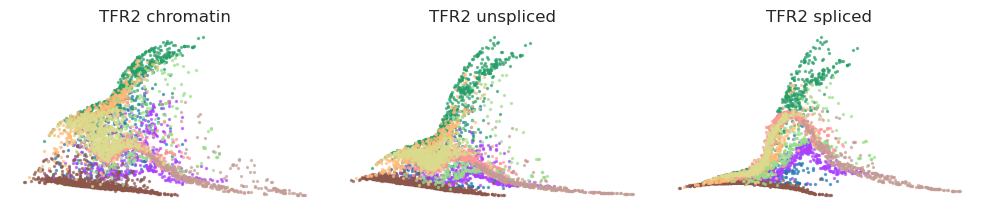

In [87]:
gene = 'TFR2'
vv.differential_dynamics_plot(adata, gene, var='kc', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.differential_dynamics_plot(adata, gene, var='rho', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.differential_dynamics_plot(adata, gene, var='v', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.differential_dynamics_plot(adata, gene, var='s', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.dynamic_plot(adata_sub2, adata_atac[adata_sub2.obs_names,:], gene, color_by='leiden', by='velocity', axis_on=False, frame_on=False)
vv.dynamic_plot(adata_sub2, adata_atac[adata_sub2.obs_names,:], gene, color_by='leiden', batch_correction=True, axis_on=False, frame_on=False)

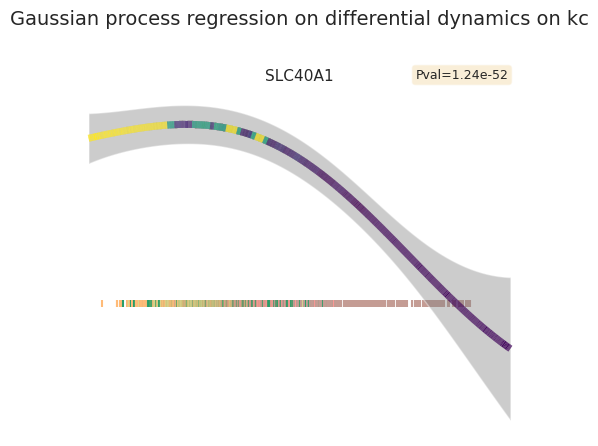

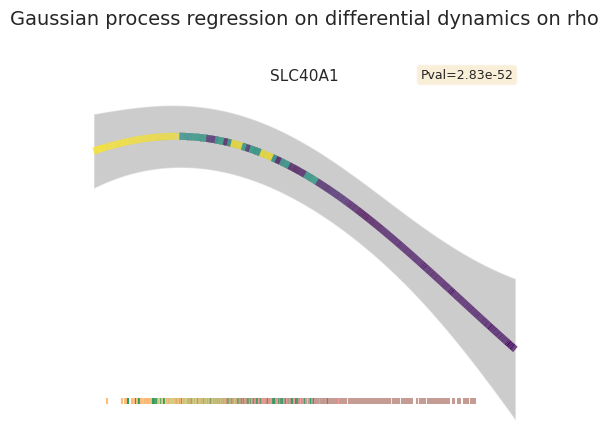

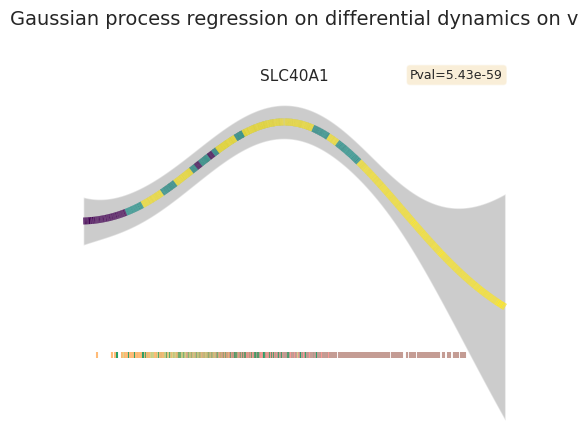

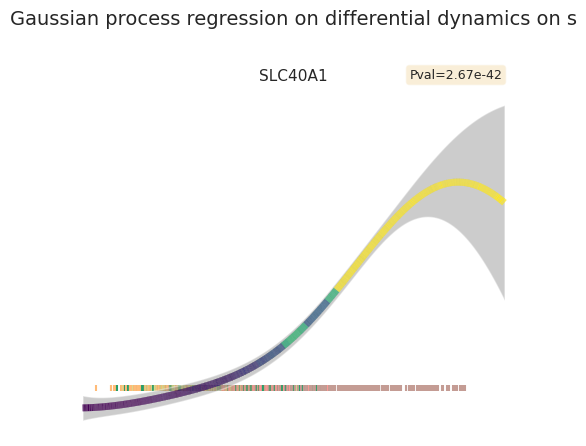

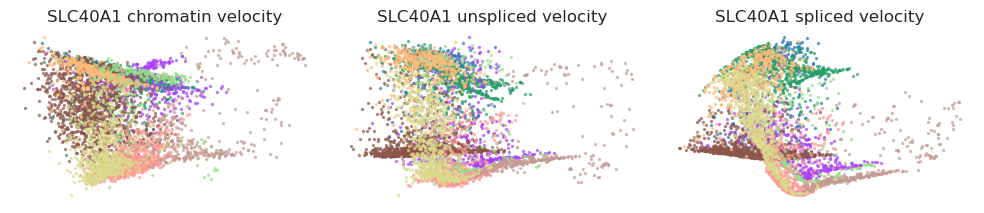

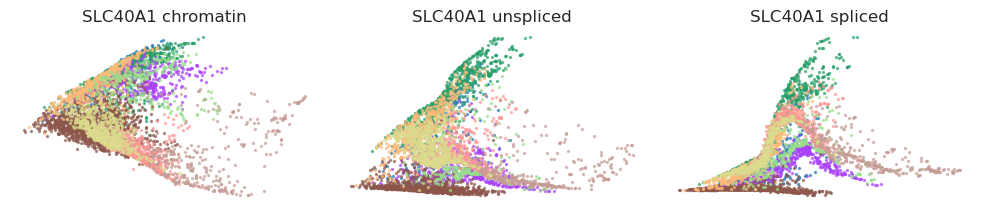

In [88]:
gene = 'SLC40A1'
vv.differential_dynamics_plot(adata, gene, var='kc', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.differential_dynamics_plot(adata, gene, var='rho', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.differential_dynamics_plot(adata, gene, var='v', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.differential_dynamics_plot(adata, gene, var='s', color_by='leiden', color_include=color_include, title=True, legend=False, axis_on=False, frame_on=False)
vv.dynamic_plot(adata_sub2, adata_atac[adata_sub2.obs_names,:], gene, color_by='leiden', by='velocity', axis_on=False, frame_on=False)
vv.dynamic_plot(adata_sub2, adata_atac[adata_sub2.obs_names,:], gene, color_by='leiden', batch_correction=True, axis_on=False, frame_on=False)

In [89]:
adata.write_h5ad(data_path_base+"/final.h5ad")

In [90]:
adata = sc.read_h5ad(data_path_base+"/final.h5ad")